# Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---


# Initialization

In [2]:
%autosave 180

Autosaving every 180 seconds


In [1]:
import cv2
import glob
import matplotlib.pyplot as plt
from matplotlib.patches import Polygon
import numpy as np

%matplotlib inline

# 1: Camera Calibration using chessboard images

In [2]:
def calibrate_camera(imgs, nx = 9, ny = 6):

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(8,4,0)
    objp = np.zeros((nx * ny, 3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2) # x, y coordinates

    for fname in imgs:    
        # read each image
        img = cv2.imread(fname)
        # convert image to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        #plt.imshow(img)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

        # If corners are found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
        
    return ret, mtx, dist, rvecs, tvecs
        
# Make a list of calibration images
imgs = glob.glob('./camera_cal/calibration*.jpg')

ret, mtx, dist, rvecs, tvecs = calibrate_camera(imgs)

# 2: Apply a distortion correction to raw images.

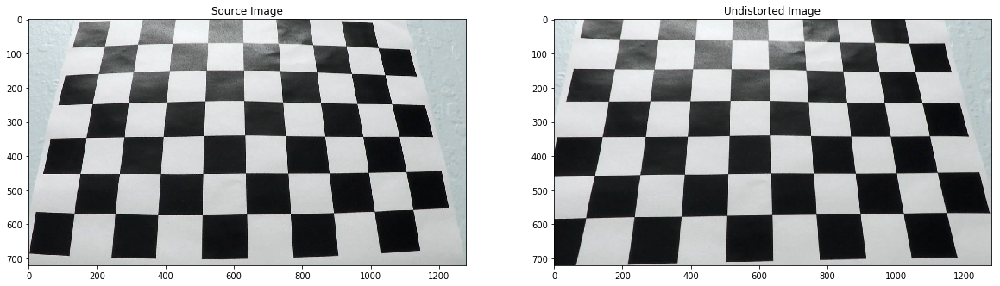

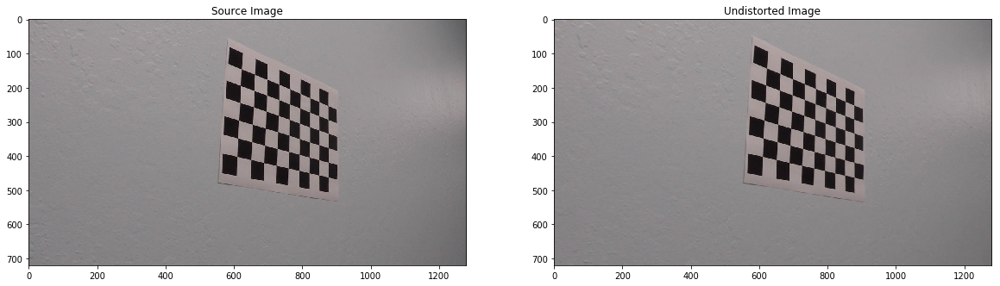

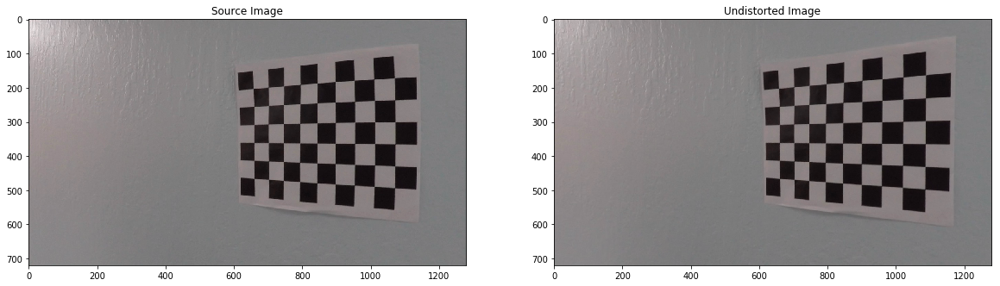

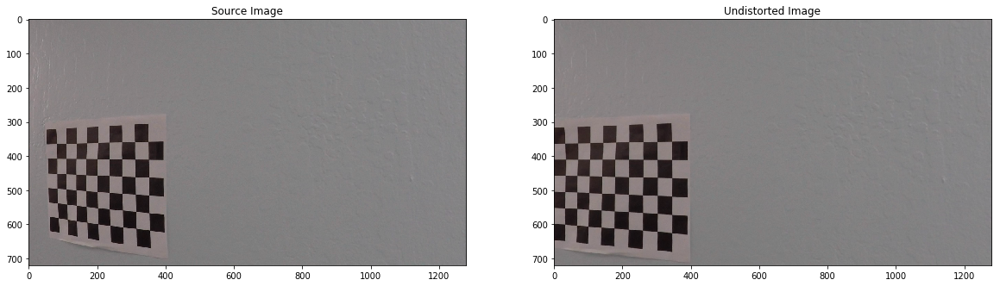

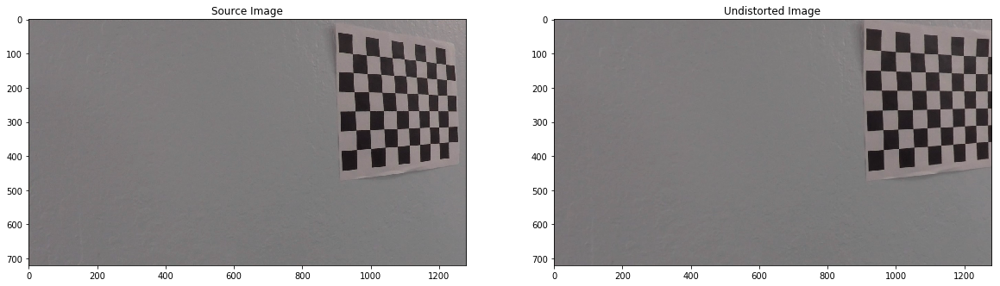

...

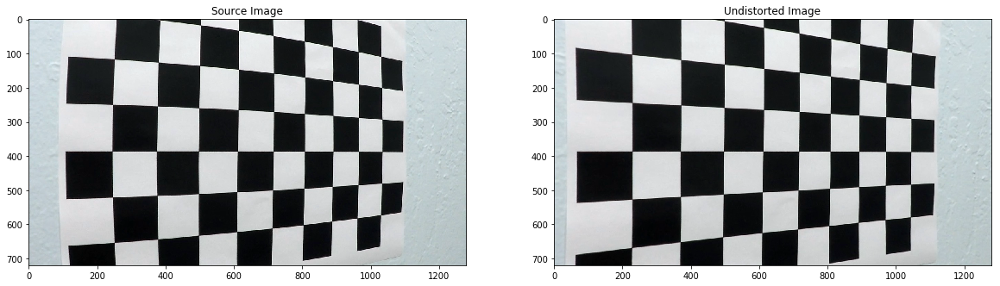

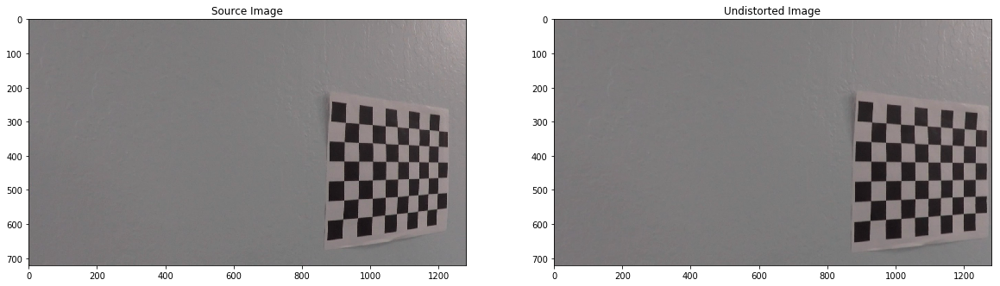

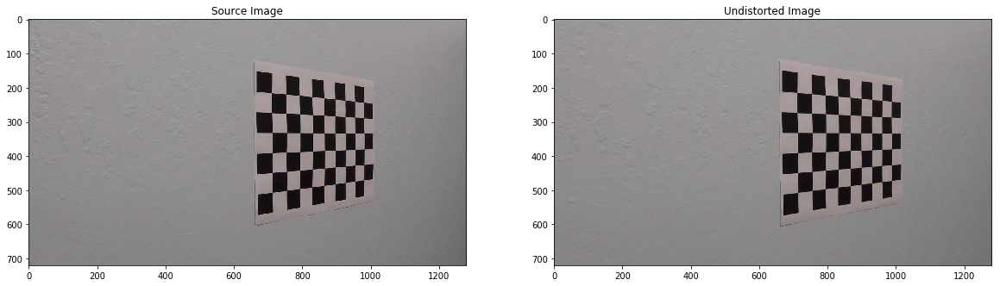

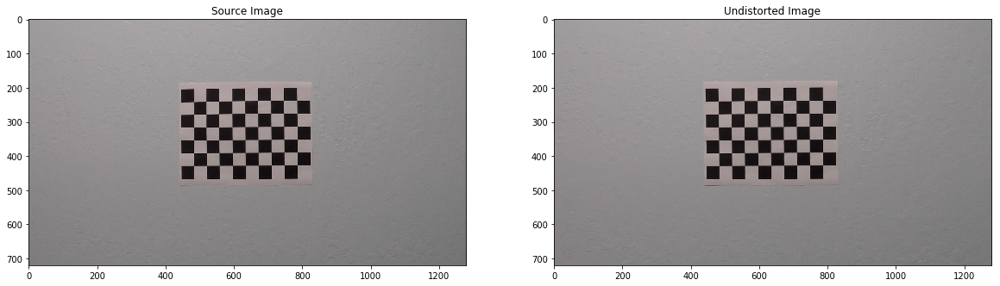

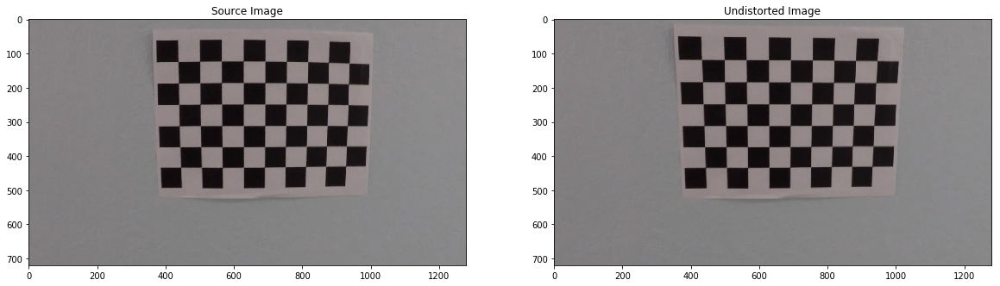

In [38]:
# Read an example image to apply distortion correction
img = cv2.imread('./camera_cal/calibration8.jpg')

#undistorted_img = cv2.undistort(img, mtx, dist, None, mtx)

#f, axarr = plt.subplots(1, 2, figsize=(20, 20))
#axarr[0].imshow(img)
#axarr[0].set_title('Source Image')
#axarr[1].imshow(undistorted_img)
#axarr[1].set_title('Undistorted Image')  

imgs = glob.glob('./camera_cal/calibration*.jpg')

for fname in imgs:    
        # read each image
        img = cv2.imread(fname)
        undistorted_img = cv2.undistort(img, mtx, dist, None, mtx)
        f, axarr = plt.subplots(1, 2, figsize=(20, 20))
        axarr[0].imshow(img)
        axarr[0].set_title('Source Image')
        axarr[1].imshow(undistorted_img)
        axarr[1].set_title('Undistorted Image')

# 3- Use color transforms, gradients, etc., to create a thresholded binary image.

Text(0.5,1,'RGB Undistorted Image')

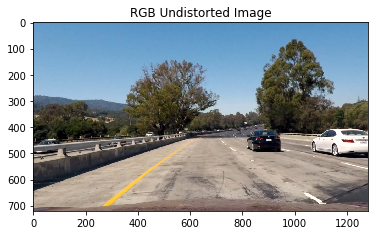

In [4]:
# Reading an example picture
original_img = cv2.imread('./test_images/test1.jpg')
# Converting to RGB scale
RGB_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
# undistord the image with the informations that we calculated 
# in the previous section
RGB_undistorderd_img = cv2.undistort(RGB_img, mtx, dist, None, mtx)
plt.imshow(RGB_undistorderd_img)
plt.title('RGB Undistorted Image')

### 3-1:Directional Gradient

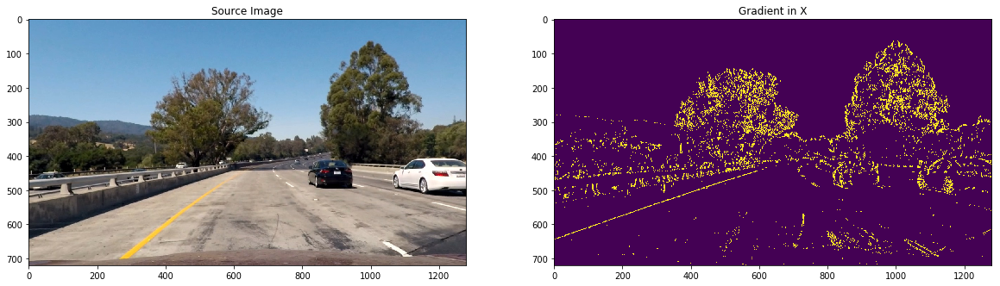

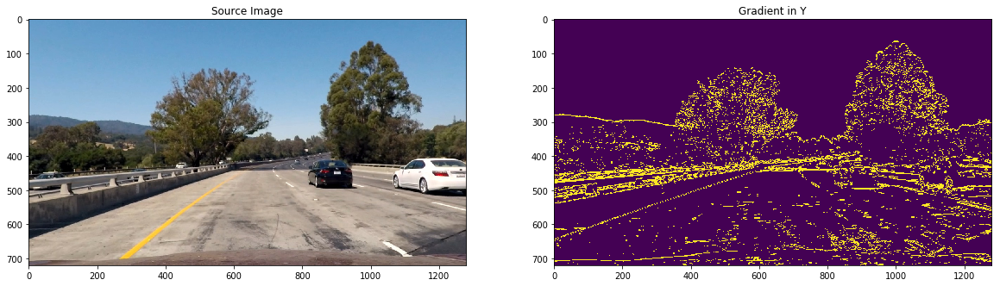

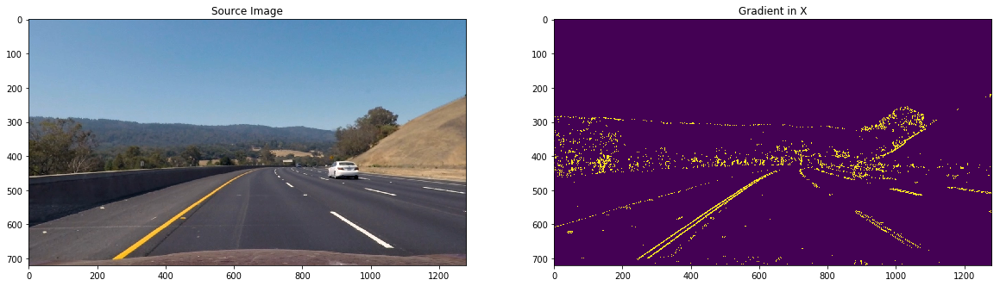

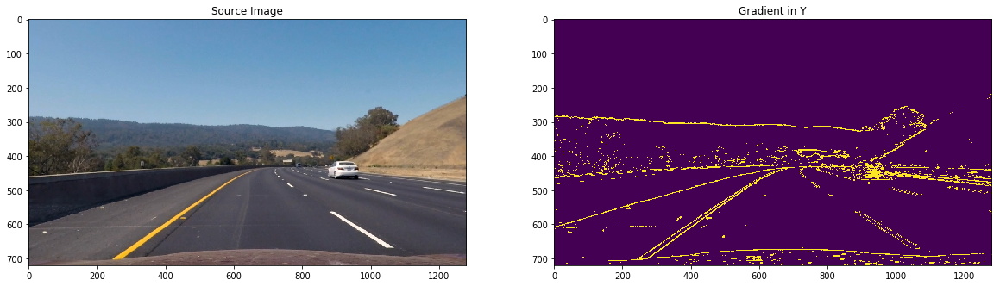

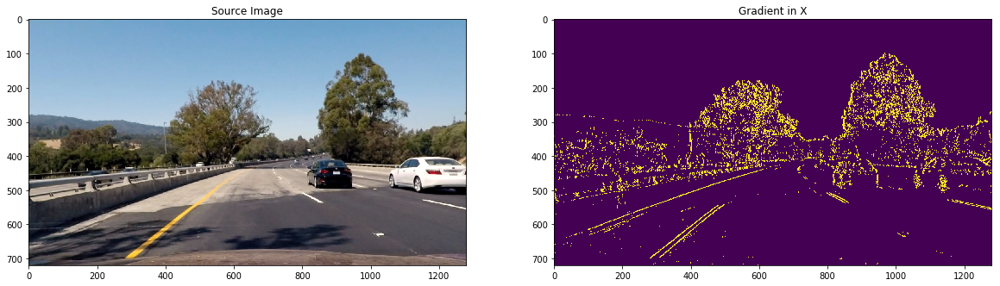

...

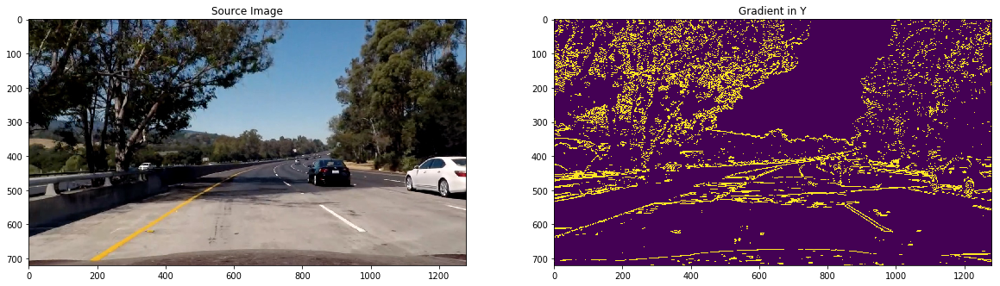

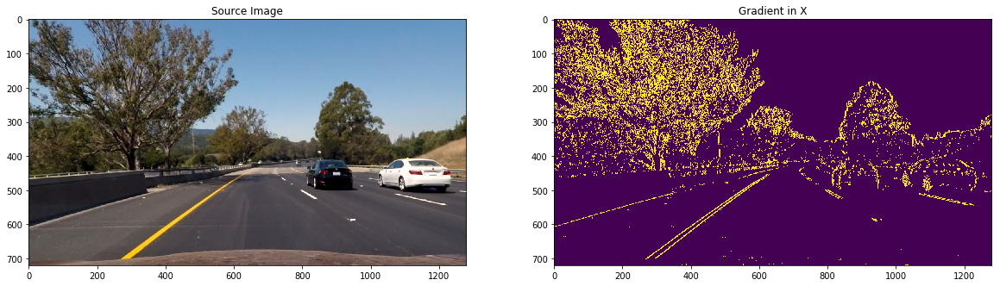

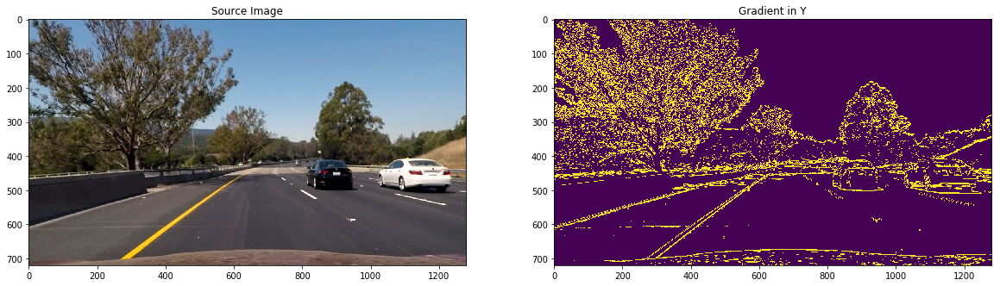

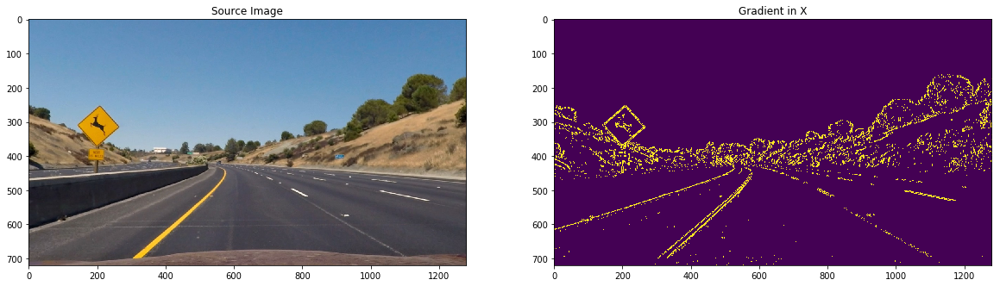

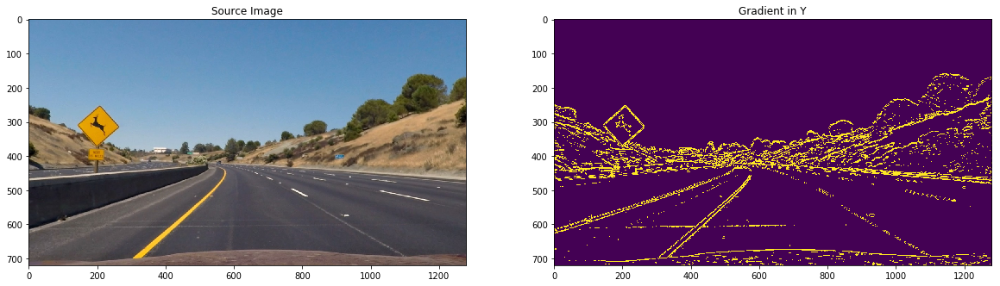

In [40]:
def abs_sobel_thresh(img, orient = 'x', sobel_kernel = 3, thresh = (0, 255)):

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        directional_sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, sobel_kernel)
    if orient == 'y':
        directional_sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, sobel_kernel)
        
    # Take the absolute value of the gradient or derivative
    abs_sobel = np.absolute(directional_sobel)
    # Scale to 8 bit integer (0-255)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Apply the threshold (the inclusive thresholding "<=, >=" would work too)
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1

    return binary_output


# computethe gradient in X
#gradient_x_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'x', sobel_kernel = 15, thresh = (20, 100))

# plot
#f, axarr = plt.subplots(1, 2, figsize=(20, 20))
#axarr[0].imshow(RGB_undistorderd_img)
#axarr[0].set_title('Source Image')
#axarr[1].imshow(gradient_x_binary)
#axarr[1].set_title('Gradient in X')

# computethe gradient in Y
#gradient_y_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'y', sobel_kernel = 15, thresh = (20, 100))

# plot
#f, axarr = plt.subplots(1, 2, figsize=(20, 20))
#axarr[0].imshow(RGB_undistorderd_img)
#axarr[0].set_title('Source Image')
#axarr[1].imshow(gradient_y_binary)
#axarr[1].set_title('Gradient in Y')

imgs = glob.glob('./test_images/test*.jpg')
for fname in imgs:    
        # read each image
        original_img = cv2.imread(fname)
        # Converting to RGB scale
        RGB_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        # undistord the image with the informations that we calculated 
        # in the previous section
        RGB_undistorderd_img = cv2.undistort(RGB_img, mtx, dist, None, mtx)
        # computethe gradient in X 
        gradient_x_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'x', sobel_kernel = 15, thresh = (20, 100))
        # plot
        f, axarr = plt.subplots(1, 2, figsize=(20, 20))
        axarr[0].imshow(RGB_undistorderd_img)
        axarr[0].set_title('Source Image')
        axarr[1].imshow(gradient_x_binary)
        axarr[1].set_title('Gradient in X')
        # computethe gradient in Y
        gradient_y_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'y', sobel_kernel = 15, thresh = (20, 100))
        # plot
        f, axarr = plt.subplots(1, 2, figsize=(20, 20))
        axarr[0].imshow(RGB_undistorderd_img)
        axarr[0].set_title('Source Image')
        axarr[1].imshow(gradient_y_binary)
        axarr[1].set_title('Gradient in Y')

### 3-2: Gradient magnitude 

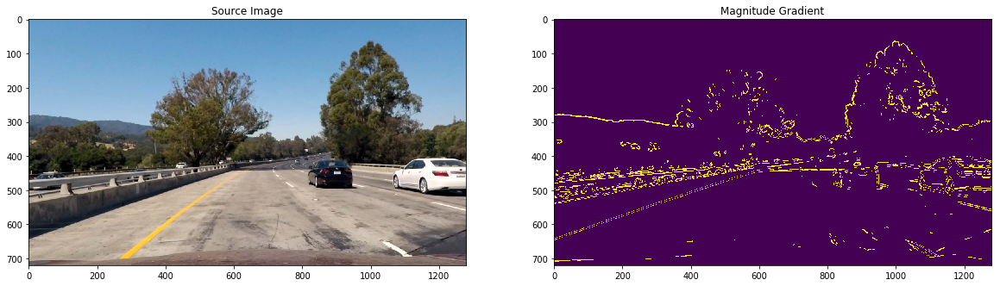

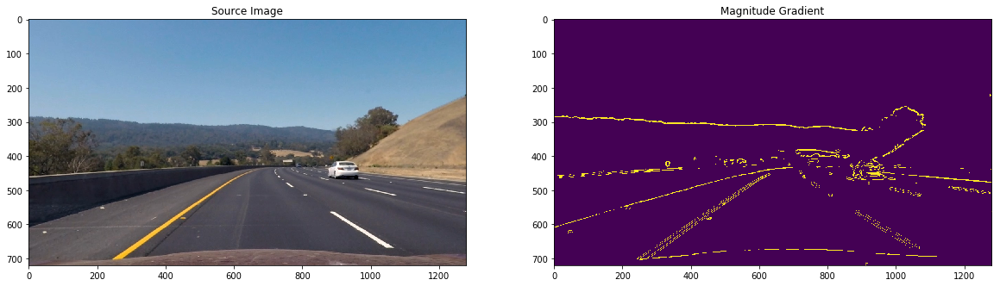

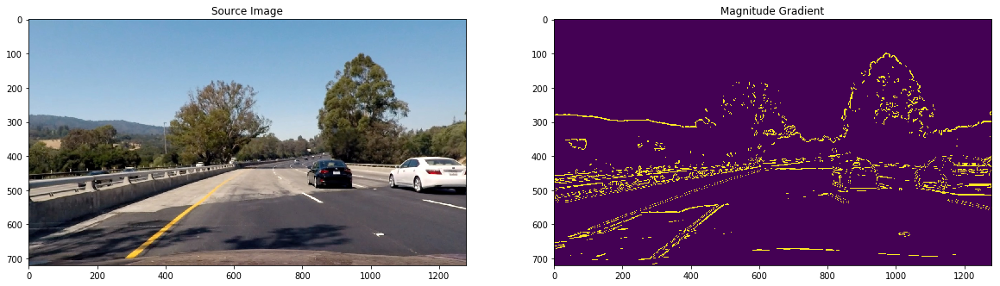

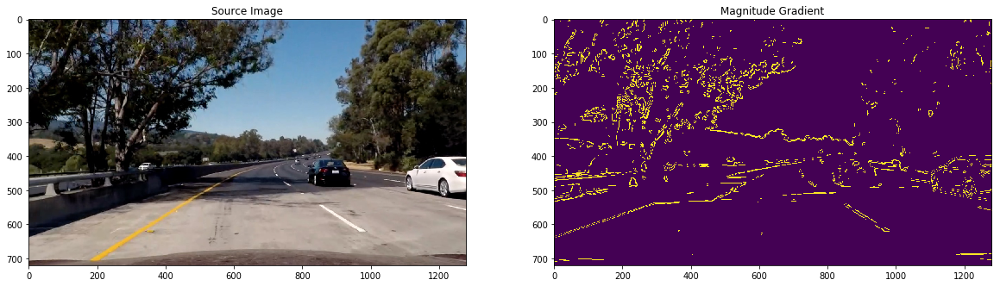

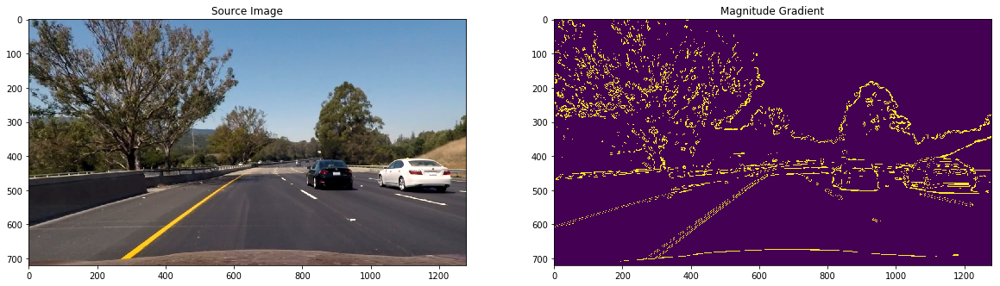

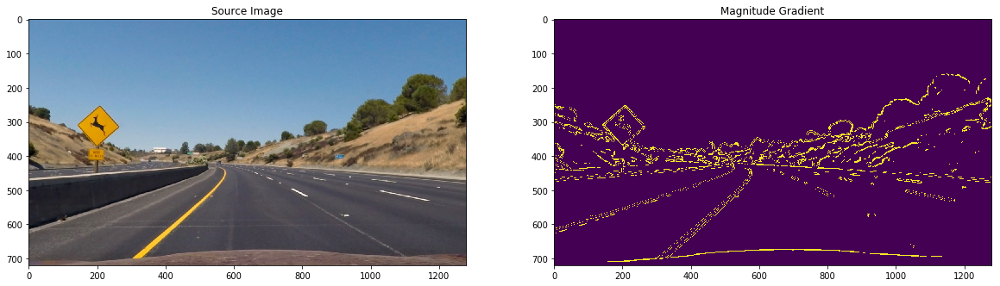

In [43]:
def mag_thres(img, sobel_kernel = 3, thresh = (0, 255)):
    
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take the gradient in x and y seperately
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    # Calculate the gradient magnitude
    abs_sobel = np.sqrt(np.power(sobel_x, 2) + np.power(sobel_y, 2))
    # Scale to 8 bit (0-255)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel)) 
    # Applying the threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1

    # Return the binary image
    return binary_output

# compute the gradient magnitude
#magnitude_gradient_binary = mag_thres(RGB_undistorderd_img, sobel_kernel = 15, thresh= (60, 100))

# plot
#f, axarr = plt.subplots(1, 2, figsize=(20, 20))
#axarr[0].imshow(RGB_undistorderd_img)
#axarr[0].set_title('Source Image')
#axarr[1].imshow(magnitude_gradient_binary)
#axarr[1].set_title('Magnitude Gradient')

imgs = glob.glob('./test_images/test*.jpg')
for fname in imgs:    
        # read each image
        original_img = cv2.imread(fname)
        # Converting to RGB scale
        RGB_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        # undistord the image with the informations that we calculated 
        # in the previous section
        RGB_undistorderd_img = cv2.undistort(RGB_img, mtx, dist, None, mtx)
        # compute the gradient magnitude
        magnitude_gradient_binary = mag_thres(RGB_undistorderd_img, sobel_kernel = 15, thresh= (60, 100))
        # plot
        f, axarr = plt.subplots(1, 2, figsize=(20, 20))
        axarr[0].imshow(RGB_undistorderd_img)
        axarr[0].set_title('Source Image')
        axarr[1].imshow(magnitude_gradient_binary)
        axarr[1].set_title('Magnitude Gradient')

#### 3-3: Gradient direction 

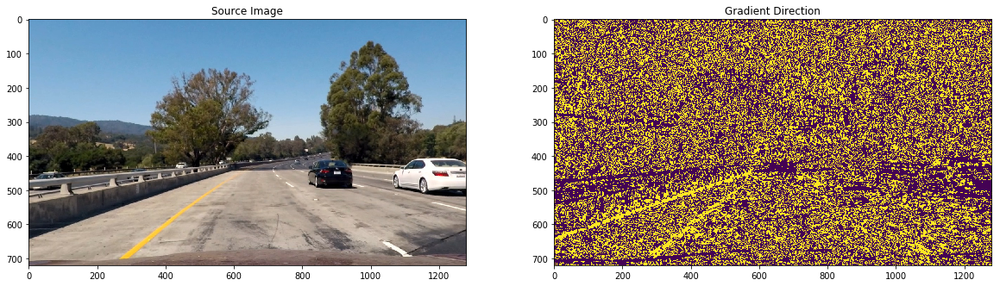

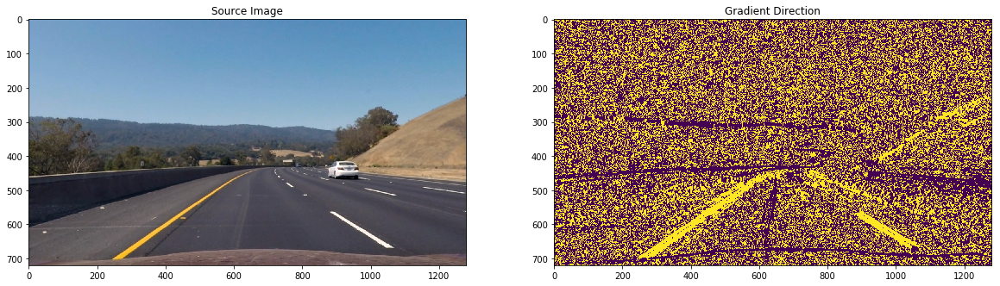

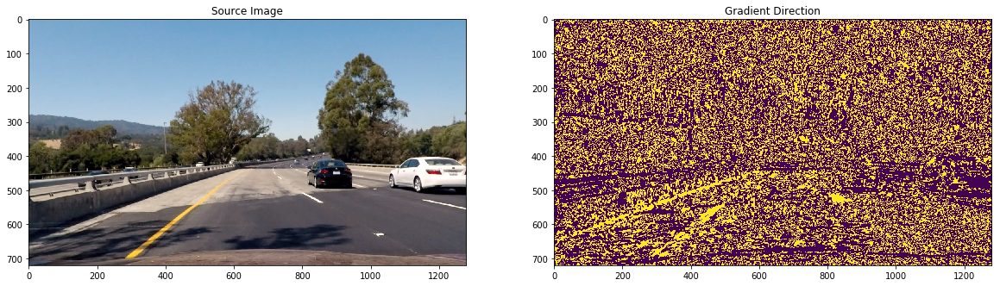

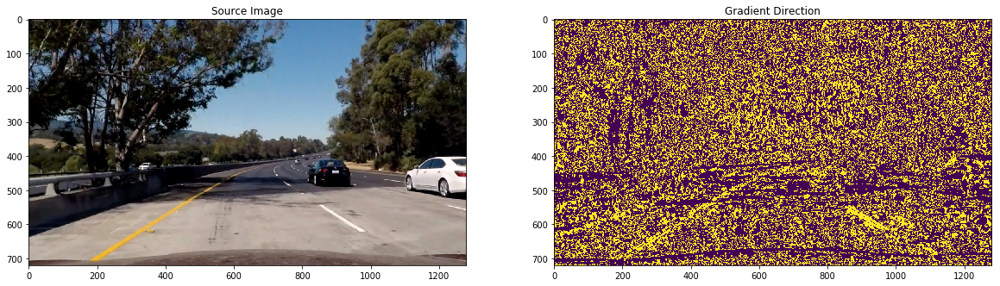

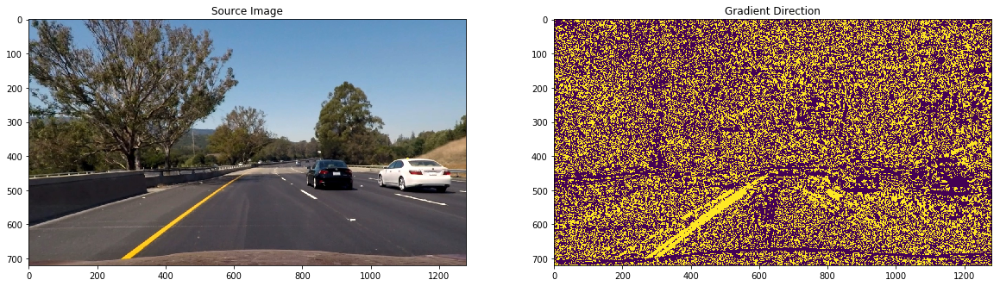

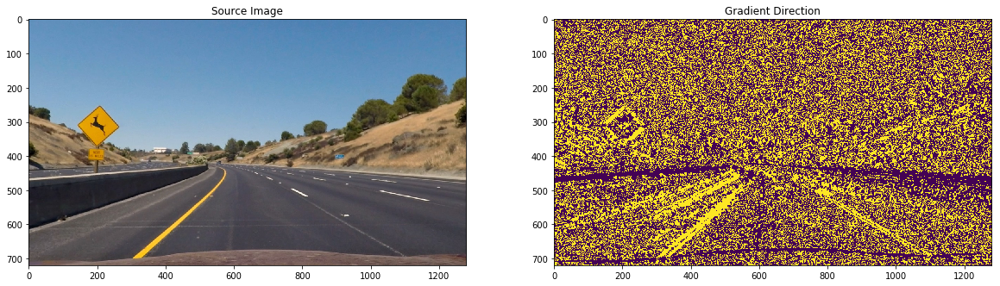

In [42]:
def dir_thresh(img, sobel_kernel = 9, thresh = (0, np.pi/2)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Take the gradient in x and y
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)

    # Take the absolute value of the x and y gradients, 
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    # Calculate the direction of the gradient by using np.arctan2()
    gradient_direction = np.arctan2(abs_sobely, abs_sobelx)
    
    # Apply a threshold
    binary_output =  np.zeros_like(gradient_direction)
    binary_output[(gradient_direction > thresh[0]) & (gradient_direction < thresh[1])] = 1

    # Return the binary image
    return binary_output

# compute gradient direction
#directional_gradient_binary = dir_thresh(RGB_undistorderd_img, sobel_kernel = 15, thresh=(0.7, 1.3))

# plot
#f, axarr = plt.subplots(1, 2, figsize=(20, 20))
#axarr[0].imshow(RGB_undistorderd_img)
#axarr[0].set_title('Source Image')
#axarr[1].imshow(directional_gradient_binary)
#axarr[1].set_title('Gradient Direction')

imgs = glob.glob('./test_images/test*.jpg')
for fname in imgs:    
        # read each image
        original_img = cv2.imread(fname)
        # Converting to RGB scale
        RGB_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        # undistord the image with the informations that we calculated 
        # in the previous section
        RGB_undistorderd_img = cv2.undistort(RGB_img, mtx, dist, None, mtx)
        # compute gradient direction
        directional_gradient_binary = dir_thresh(RGB_undistorderd_img, sobel_kernel = 15, thresh=(0.7, 1.3))
        # plot
        f, axarr = plt.subplots(1, 2, figsize=(20, 20))
        axarr[0].imshow(RGB_undistorderd_img)
        axarr[0].set_title('Source Image')
        axarr[1].imshow(directional_gradient_binary)
        axarr[1].set_title('Gradient Direction')

### 3-4: Color threshold

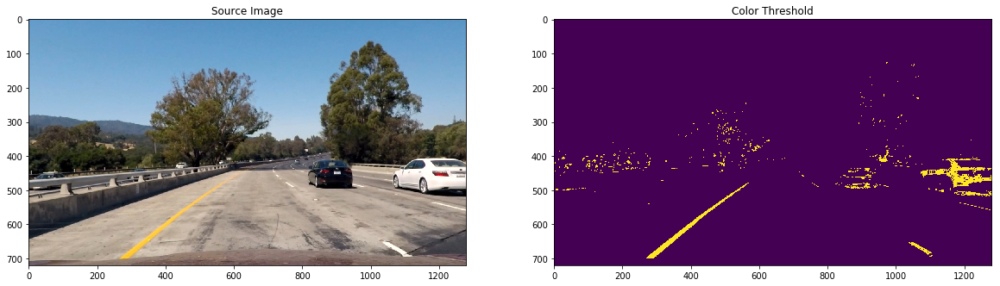

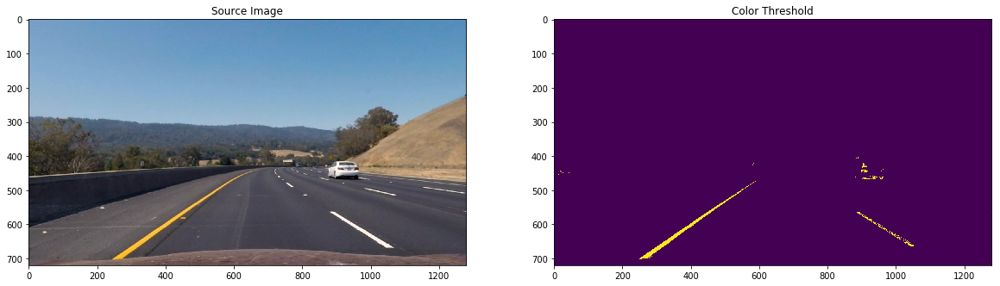

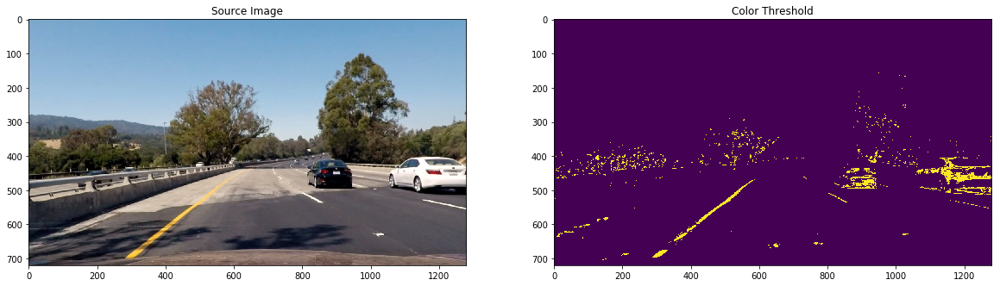

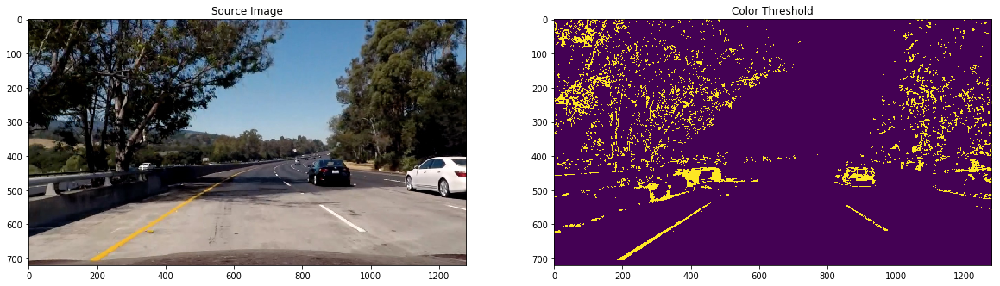

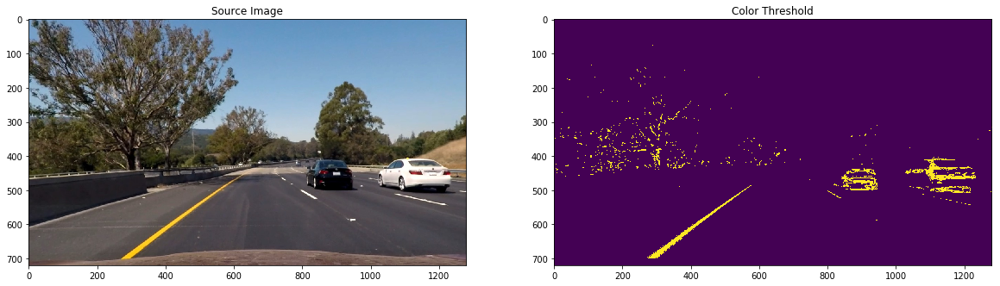

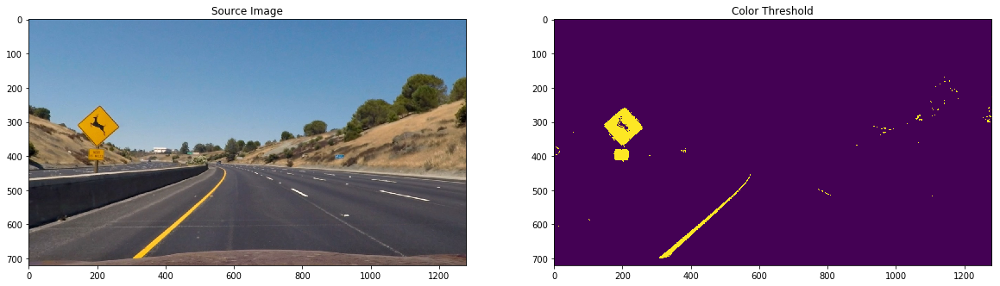

In [44]:
def color_thresh(img, thresh = (170, 255)):
    # Convert to HLS space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    
    # Selecting the S Channel as it has the best performance for this specific task
    hls_s_channel = hls[:, :, 2] 
    
    binary_output = np.zeros_like(hls_s_channel)
    binary_output[(hls_s_channel >= thresh[0]) & (hls_s_channel <= thresh[1])] = 1

    # Return the binary image
    return binary_output

# compute color threshold
#color_threshold_binary = color_thresh(RGB_undistorderd_img, thresh = (180, 255))

# plot
#f, axarr = plt.subplots(1, 2, figsize=(20, 20))
#axarr[0].imshow(RGB_undistorderd_img)
#axarr[0].set_title('Source Image')
#axarr[1].imshow(color_threshold_binary)
#axarr[1].set_title('Color Threshold')

imgs = glob.glob('./test_images/test*.jpg')
for fname in imgs:    
        # read each image
        original_img = cv2.imread(fname)
        # Converting to RGB scale
        RGB_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        # undistord the image with the informations that we calculated 
        # in the previous section
        RGB_undistorderd_img = cv2.undistort(RGB_img, mtx, dist, None, mtx)
        # compute color threshold
        color_threshold_binary = color_thresh(RGB_undistorderd_img, thresh = (180, 255))
        # plot
        f, axarr = plt.subplots(1, 2, figsize=(20, 20))
        axarr[0].imshow(RGB_undistorderd_img)
        axarr[0].set_title('Source Image')
        axarr[1].imshow(color_threshold_binary)
        axarr[1].set_title('Color Threshold')

### 3-5: Combining all different thresholds

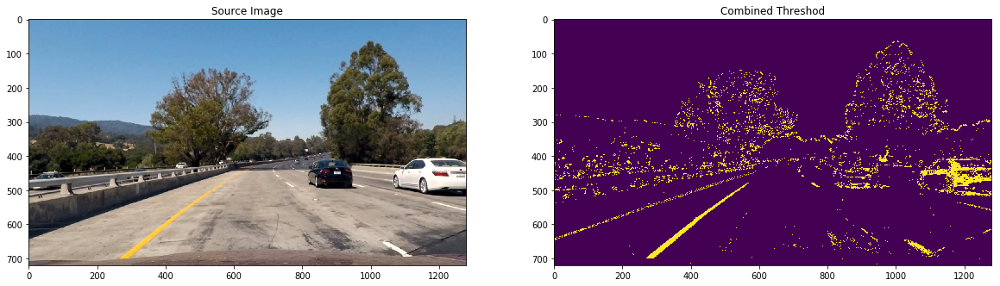

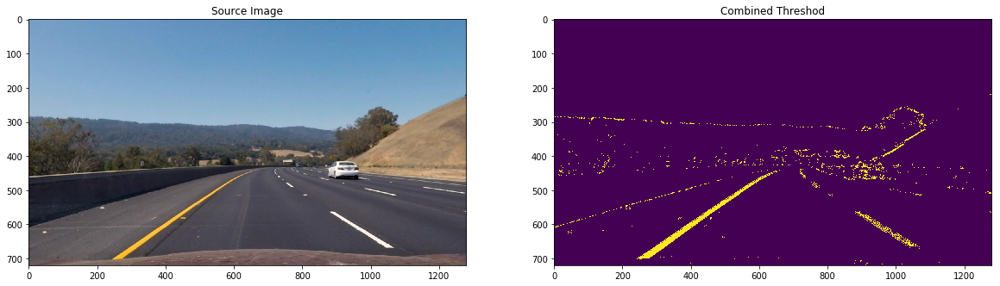

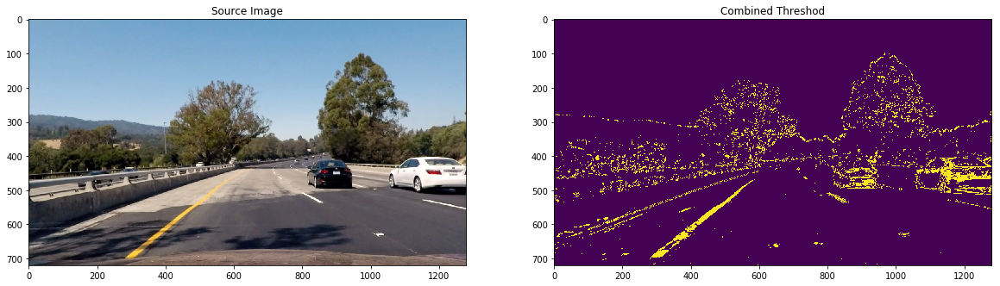

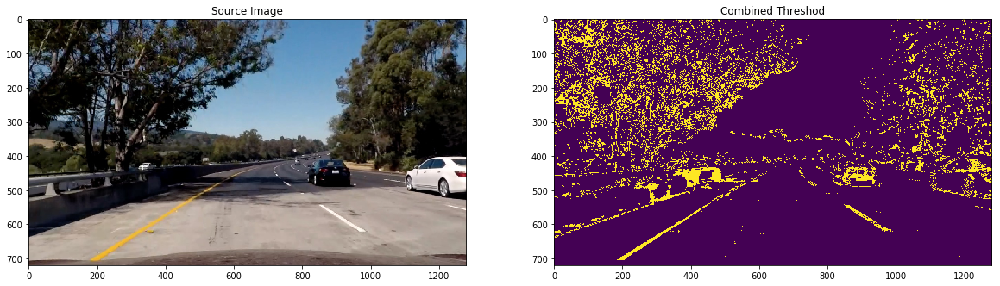

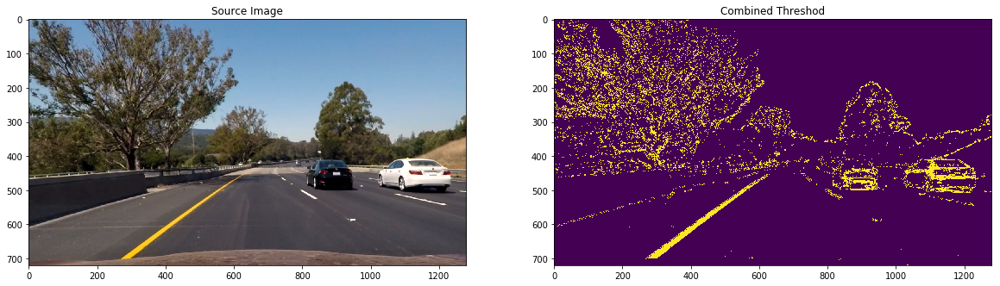

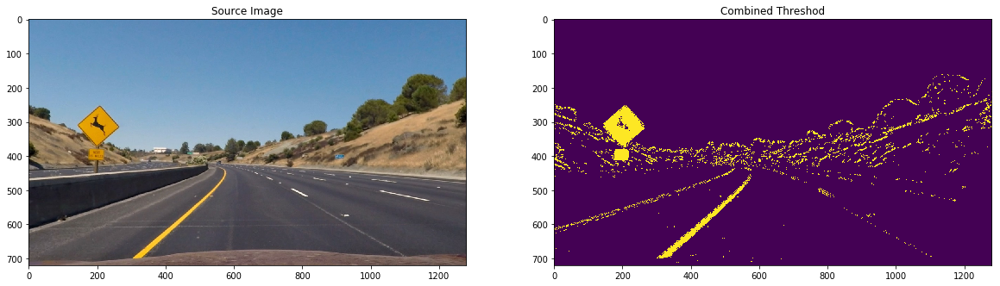

In [46]:
def combined_threshs(gradient_x_binary, gradient_y_binary, magnitude_gradient_binary, directional_gradient_binary, color_threshold_binary, ksize = 15):
    
    # Combining all different thresholds
    combined_threshod_binary = np.zeros_like(color_threshold_binary)
    combined_threshod_binary[((gradient_x_binary == 1) & (gradient_y_binary == 1)) | ((magnitude_gradient_binary == 1) & (directional_gradient_binary == 1)) | (color_threshold_binary == 1)] = 1

    return combined_threshod_binary


# Combined Threshold
#combined_threshod_binary = combined_threshs(gradient_x_binary, gradient_y_binary, magnitude_gradient_binary, directional_gradient_binary, color_threshold_binary, ksize = 15)

# plot
#f, axarr = plt.subplots(1, 2, figsize=(20, 20))
#axarr[0].imshow(RGB_undistorderd_img)
#axarr[0].set_title('Source Image')
#axarr[1].imshow(combined_threshod_binary)
#axarr[1].set_title('Combined Threshod')

imgs = glob.glob('./test_images/test*.jpg')
for fname in imgs:    
        # read each image
        original_img = cv2.imread(fname)
        # Converting to RGB scale
        RGB_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        # undistord the image with the informations that we calculated 
        # in the previous section
        RGB_undistorderd_img = cv2.undistort(RGB_img, mtx, dist, None, mtx)
        # computethe gradient in X 
        gradient_x_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'x', sobel_kernel = 15, thresh = (20, 100))
        # computethe gradient in Y
        gradient_y_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'y', sobel_kernel = 15, thresh = (20, 100))
        # compute the gradient magnitude
        magnitude_gradient_binary = mag_thres(RGB_undistorderd_img, sobel_kernel = 15, thresh= (60, 100))
        # compute gradient direction
        directional_gradient_binary = dir_thresh(RGB_undistorderd_img, sobel_kernel = 15, thresh=(0.7, 1.3))
        # compute color threshold
        color_threshold_binary = color_thresh(RGB_undistorderd_img, thresh = (180, 255))
        # Combined Threshold
        combined_threshod_binary = combined_threshs(gradient_x_binary, gradient_y_binary, magnitude_gradient_binary, directional_gradient_binary, color_threshold_binary, ksize = 15)
        # plot
        f, axarr = plt.subplots(1, 2, figsize=(20, 20))
        axarr[0].imshow(RGB_undistorderd_img)
        axarr[0].set_title('Source Image')
        axarr[1].imshow(combined_threshod_binary)
        axarr[1].set_title('Combined Threshod')

# 4- Apply a perspective transform to rectify binary image ("birds-eye view").

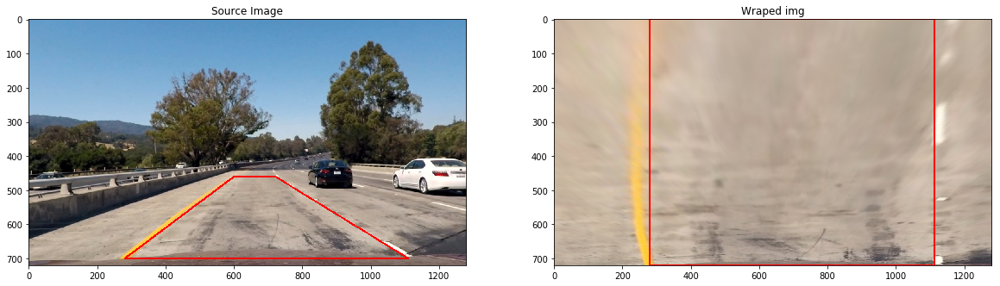

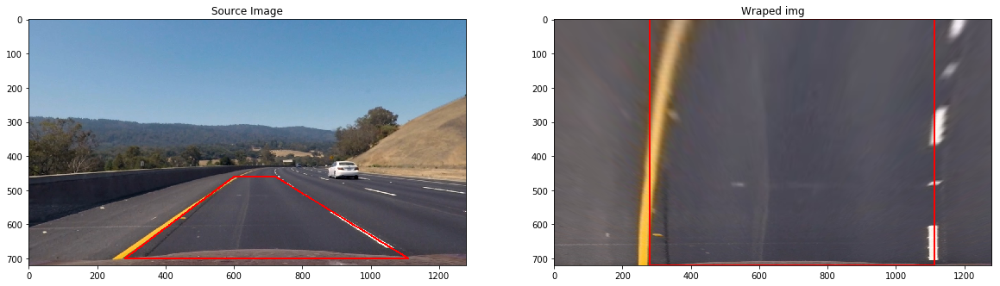

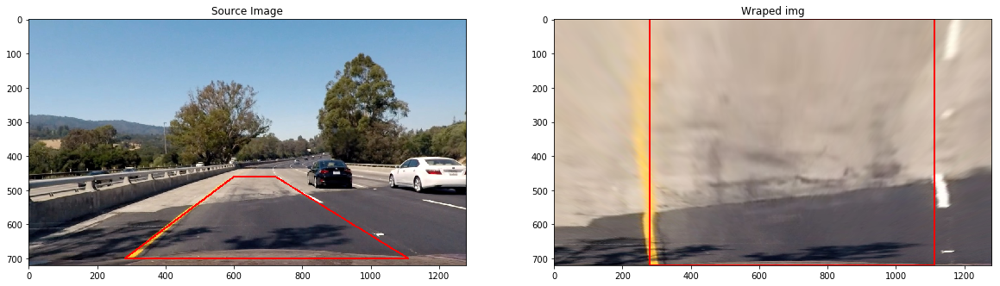

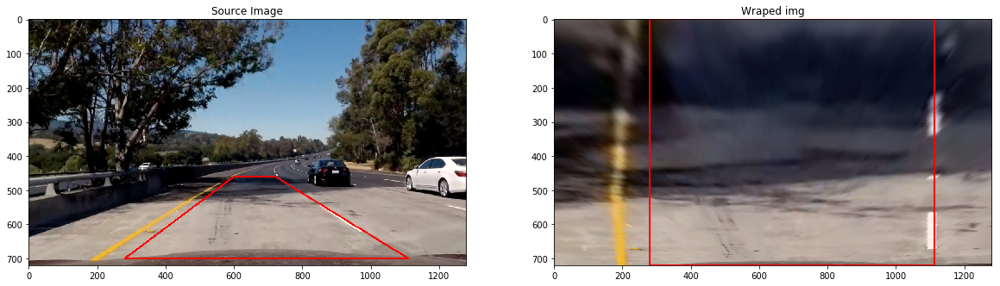

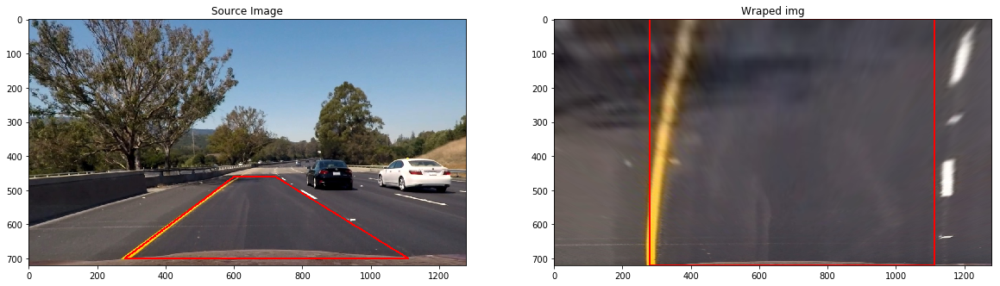

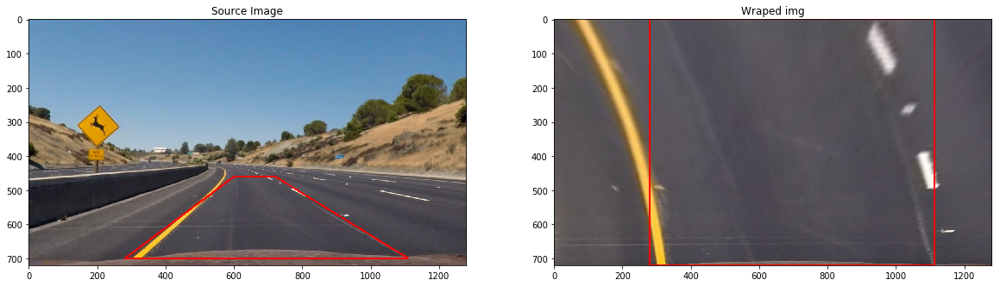

In [53]:
def warp(img):
    
    # Define calibration box in source (original) and destination (desired or warped) coordinates
    img_size = (img.shape[1], img.shape[0])
    
    # Source points
    src = np.float32(
        [[280,700],   # bottom-left
        [600,460],   # top-left
        [720,460],   # top-right
        [1110,700]]) # bottom-right

    # Destination points
    dst = np.float32(
        [[280,  img_size[1]],  # Bottom left
         [280,    0],  # Top left
         [1110,   0],  # Top right
         [1110, img_size[1]]]) # Bottom right   
      
    # Compute the perspective transfor, M
    M = cv2.getPerspectiveTransform(src, dst)
    
    # Compute the inverse perspective transfor, M_inv
    M_inv = cv2.getPerspectiveTransform(dst, src)
    
    # Create warped image - uses linear interpolation
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)

    return warped, M, M_inv, src, dst

# Warped image
#warped_img, M, M_inv, src, dst = warp(RGB_undistorderd_img)

# plot
#f, axarr = plt.subplots(1, 2, figsize = (20, 20))
#RGB_undistorderd_img = cv2.polylines(RGB_undistorderd_img, np.int32([src]), True, (255, 0, 0), 3) 
#axarr[0].imshow(RGB_undistorderd_img)
#axarr[0].set_title('Source Image')
#warped_img = cv2.polylines(warped_img, np.int32([dst]), True, (255, 0, 0), 3)
#axarr[1].imshow(warped_img)
#axarr[1].set_title('Wraped img')

imgs = glob.glob('./test_images/test*.jpg')
for fname in imgs:    
        # read each image
        original_img = cv2.imread(fname)
        # Converting to RGB scale
        RGB_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        # undistord the image with the informations that we calculated 
        # in the previous section
        RGB_undistorderd_img = cv2.undistort(RGB_img, mtx, dist, None, mtx)
        # Warped image
        warped_img, M, M_inv, src, dst = warp(RGB_undistorderd_img)
        # plot
        f, axarr = plt.subplots(1, 2, figsize = (20, 20))
        RGB_undistorderd_img = cv2.polylines(RGB_undistorderd_img, np.int32([src]), True, (255, 0, 0), 3) 
        axarr[0].imshow(RGB_undistorderd_img)
        axarr[0].set_title('Source Image')
        warped_img = cv2.polylines(warped_img, np.int32([dst]), True, (255, 0, 0), 3)
        axarr[1].imshow(warped_img)
        axarr[1].set_title('Wraped img')

# 5: Detect lane pixels and fit to find the lane boundary.

### 5-1: Applying the perspective transform to the combined thresholded image

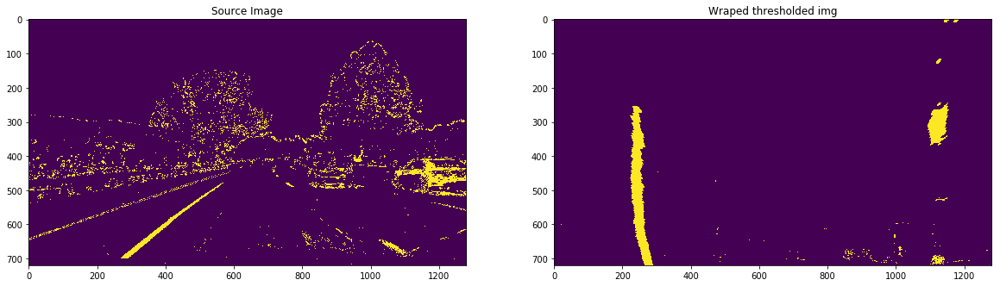

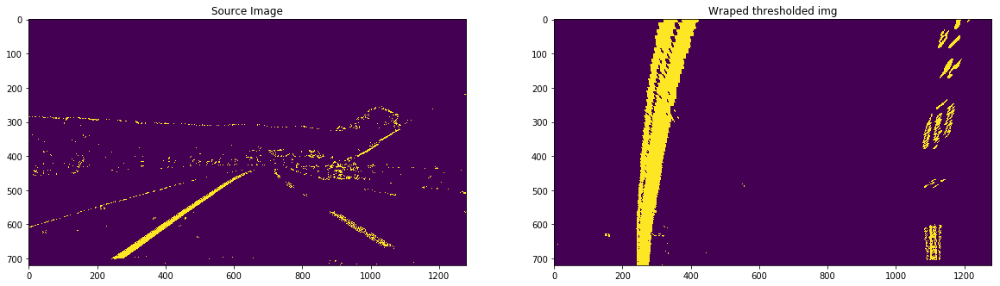

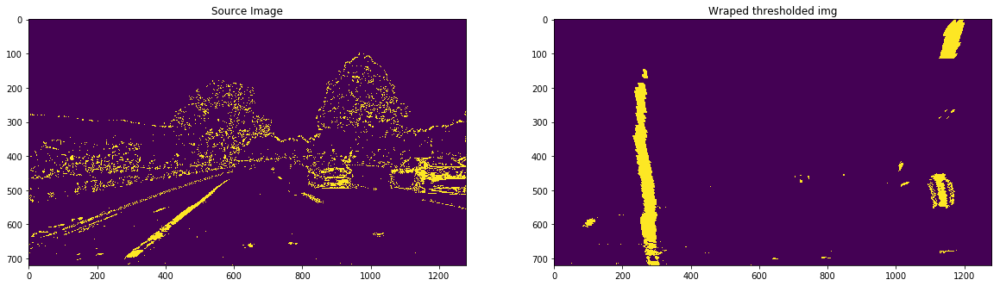

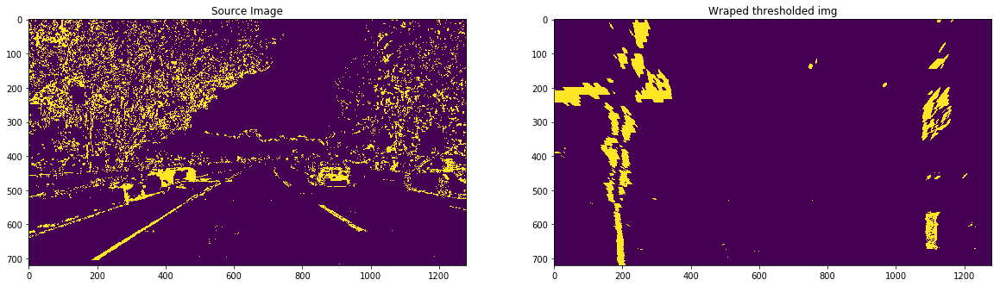

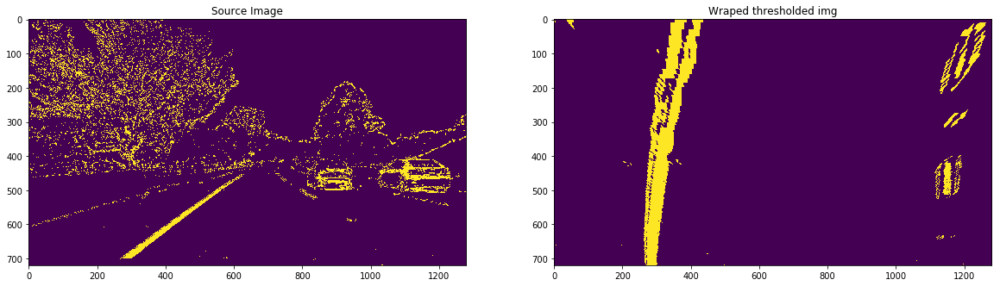

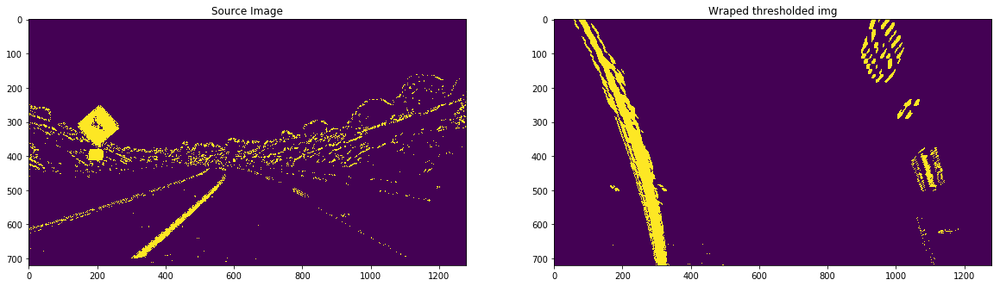

In [54]:
# Warped Thresholded Img
#warped_thresholded_img, M, M_inv, src, dst = warp(combined_threshod_binary)

# plot
#f, axarr = plt.subplots(1, 2, figsize = (20, 20))
#axarr[0].imshow(combined_threshod_binary)
#axarr[0].set_title('Source Image')
#axarr[1].imshow(warped_thresholded_img)
#axarr[1].set_title('Wraped thresholded img')

imgs = glob.glob('./test_images/test*.jpg')
for fname in imgs:    
        # read each image
        original_img = cv2.imread(fname)
        # Converting to RGB scale
        RGB_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        # undistord the image with the informations that we calculated 
        # in the previous section
        RGB_undistorderd_img = cv2.undistort(RGB_img, mtx, dist, None, mtx)
        # computethe gradient in X 
        gradient_x_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'x', sobel_kernel = 15, thresh = (20, 100))
        # computethe gradient in Y
        gradient_y_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'y', sobel_kernel = 15, thresh = (20, 100))
        # compute the gradient magnitude
        magnitude_gradient_binary = mag_thres(RGB_undistorderd_img, sobel_kernel = 15, thresh= (60, 100))
        # compute gradient direction
        directional_gradient_binary = dir_thresh(RGB_undistorderd_img, sobel_kernel = 15, thresh=(0.7, 1.3))
        # compute color threshold
        color_threshold_binary = color_thresh(RGB_undistorderd_img, thresh = (180, 255))
        # Combined Threshold
        combined_threshod_binary = combined_threshs(gradient_x_binary, gradient_y_binary, magnitude_gradient_binary, directional_gradient_binary, color_threshold_binary, ksize = 15)
        # Warped Thresholded Img
        warped_thresholded_img, M, M_inv, src, dst = warp(combined_threshod_binary)
        # plot
        f, axarr = plt.subplots(1, 2, figsize = (20, 20))
        axarr[0].imshow(combined_threshod_binary)
        axarr[0].set_title('Source Image')
        axarr[1].imshow(warped_thresholded_img)
        axarr[1].set_title('Wraped thresholded img')

### 5-2: Computing the histogram of the thresholded wraped image

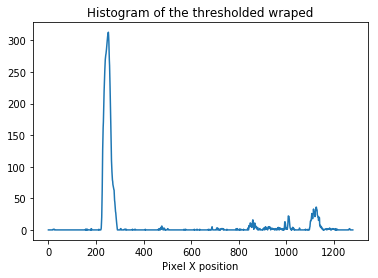

In [64]:
def hist(img):
    histogram = np.sum(img[img.shape[0]//2:, :], axis = 0)
    return histogram


histogram = hist(warped_thresholded_img)

# Plot the results
plt.title('Histogram of the thresholded wraped')
plt.xlabel('Pixel X position')
plt.plot(histogram)

### 5-3: Sliding Windows and Fit a Polynomial

In [13]:
def find_lane_pixels(img):
    
    # Take a histogram of the bottom half of the image
    histogram = hist(img)

    # create an output image to draw on and visualize the result 
    out_img = np.dstack((img, img, img))
    
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    
    # Set height of windows
    window_height = np.int(img.shape[0]//nwindows)
        
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzerox = np.array(nonzero[1])   
    nonzeroy = np.array(nonzero[0])
   
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window + 1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
                      (win_xleft_high,win_y_high), (0,255,0), 4) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
                      (win_xright_high,win_y_high), (0,255,0), 4) 

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                          (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                           (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        pass
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    return leftx, lefty, rightx, righty, out_img 

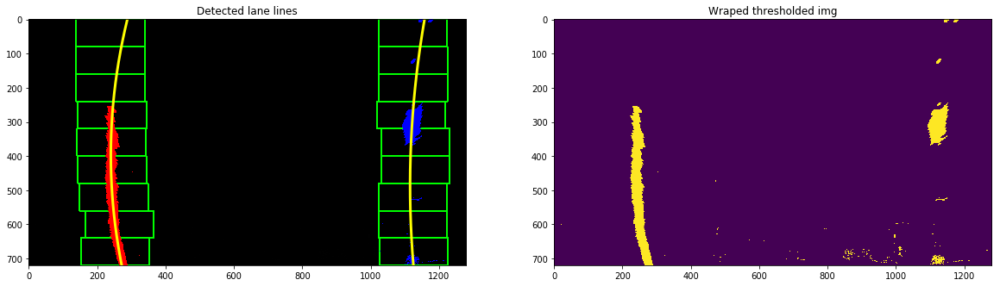

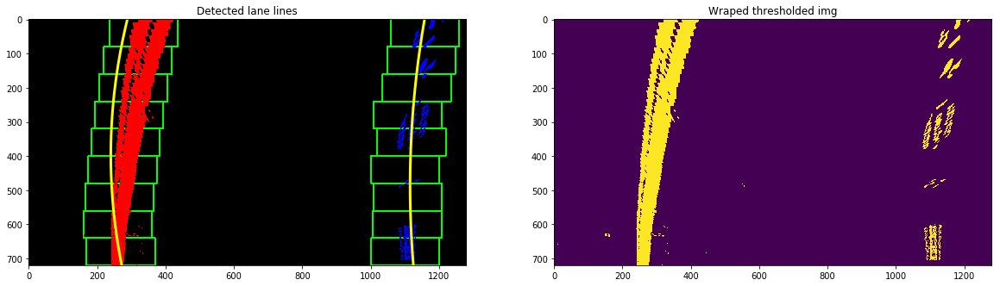

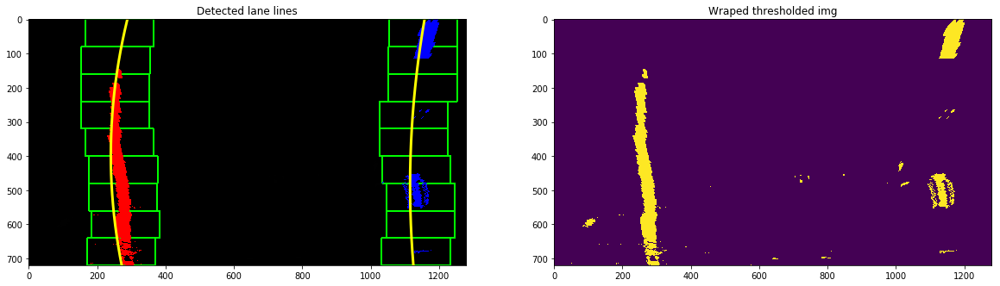

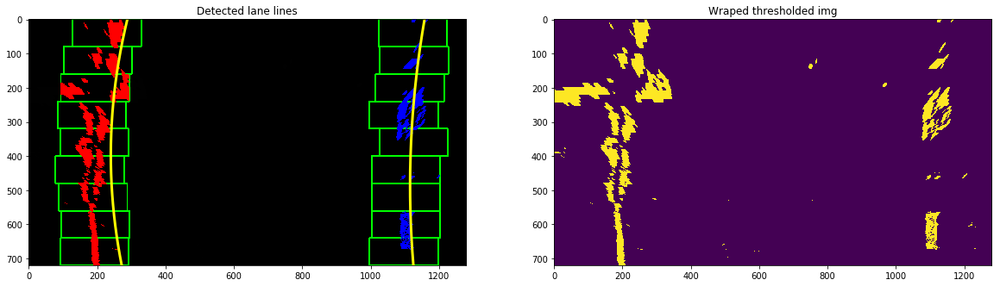

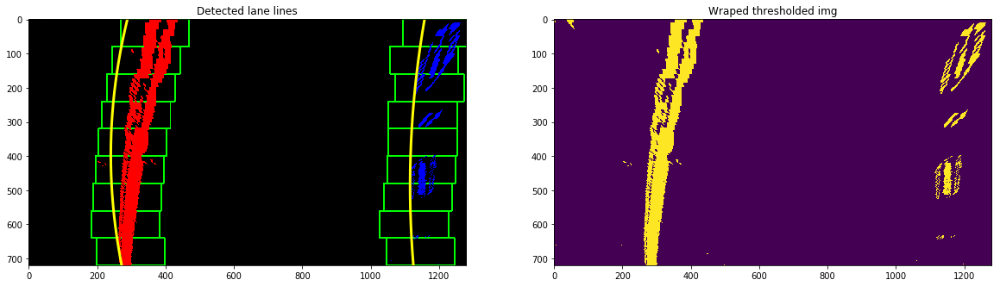

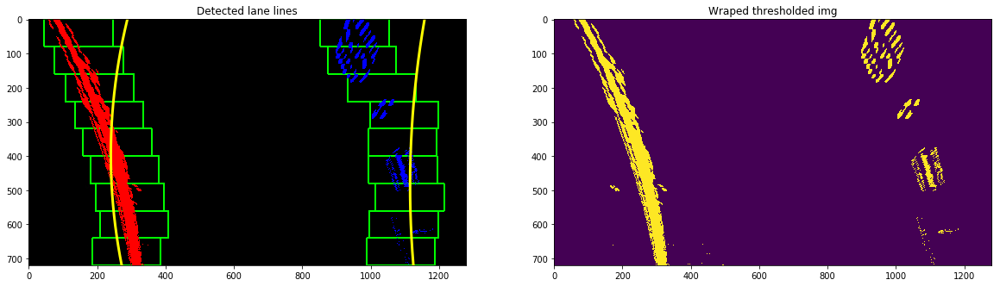

In [67]:
def fit_polynomial(img):
    #Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(img)
    
    #Fit a second order polynomial
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, img.shape[0] - 1, img.shape[0])
    
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
            print('The function failed to fit a line!')
            left_fitx = 1*ploty**2 + 1*ploty
            right_fitx = 1*ploty**2 + 1*ploty
            
    #Visualizatio
    # colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    
    # Plots the left and right polynomials on the lane lines
    #plt.plot(left_fitx, ploty, color = 'yellow', linewidth = 3)
    #plt.plot(right_fitx, ploty, color = "yellow", linewidth = 3)
    
    return out_img, left_fit, right_fit, leftx, lefty, rightx, righty


#out_img, left_fit, right_fit, leftx, lefty, rightx, righty = fit_polynomial(warped_thresholded_img)

## plot
#plt.imshow(out_img)
#plt.title('Detected lane lines')

imgs = glob.glob('./test_images/test*.jpg')
for fname in imgs:    
        # read each image
        original_img = cv2.imread(fname)
        # Converting to RGB scale
        RGB_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        # undistord the image with the informations that we calculated 
        # in the previous section
        RGB_undistorderd_img = cv2.undistort(RGB_img, mtx, dist, None, mtx)
        # computethe gradient in X 
        gradient_x_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'x', sobel_kernel = 15, thresh = (20, 100))
        # computethe gradient in Y
        gradient_y_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'y', sobel_kernel = 15, thresh = (20, 100))
        # compute the gradient magnitude
        magnitude_gradient_binary = mag_thres(RGB_undistorderd_img, sobel_kernel = 15, thresh= (60, 100))
        # compute gradient direction
        directional_gradient_binary = dir_thresh(RGB_undistorderd_img, sobel_kernel = 15, thresh=(0.7, 1.3))
        # compute color threshold
        color_threshold_binary = color_thresh(RGB_undistorderd_img, thresh = (180, 255))
        # Combined Threshold
        combined_threshod_binary = combined_threshs(gradient_x_binary, gradient_y_binary, magnitude_gradient_binary, directional_gradient_binary, color_threshold_binary, ksize = 15)
        # Warped Thresholded Img
        warped_thresholded_img, M, M_inv, src, dst = warp(combined_threshod_binary)
        out_img, left_fit, right_fit, leftx, lefty, rightx, righty = fit_polynomial(warped_thresholded_img)
        # plot
        f, axarr = plt.subplots(1, 2, figsize = (20, 20))
        axarr[0].imshow(out_img)
        # Plots the left and right polynomials on the lane lines
        axarr[0].plot(left_fitx, ploty, color = 'yellow', linewidth = 3)
        axarr[0].plot(right_fitx, ploty, color = "yellow", linewidth = 3)
        axarr[0].set_title('Detected lane lines')
        axarr[1].imshow(warped_thresholded_img)
        axarr[1].set_title('Wraped thresholded img')

### 5-4: Skip the sliding windows step once lane lines are detected

In [15]:
def fit_poly (img_shape, leftx, lefty, rightx, righty):
    # Fitting a second order polynomial to each lane line
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    
    # Calculatue both polynomials
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty

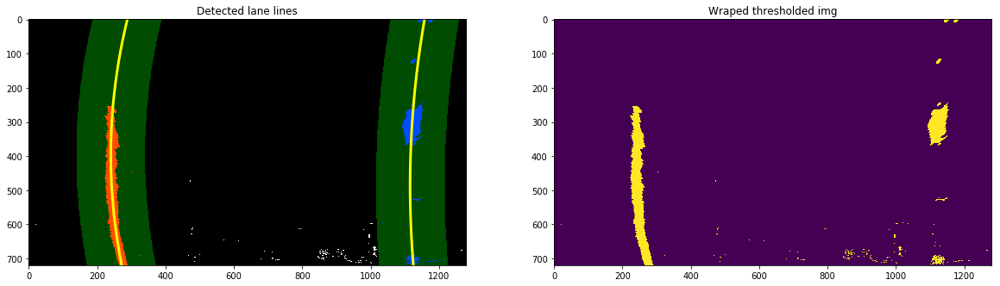

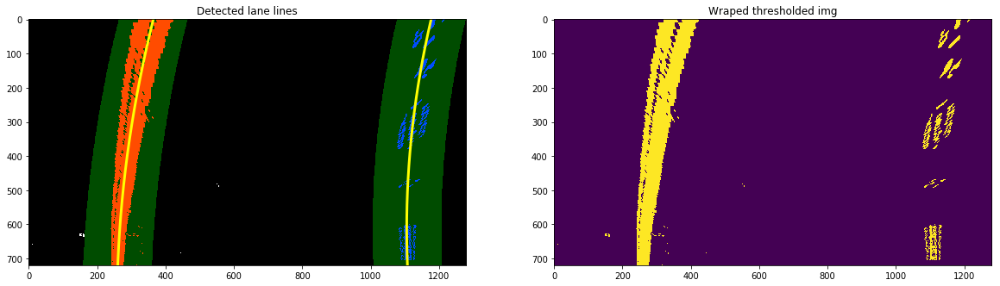

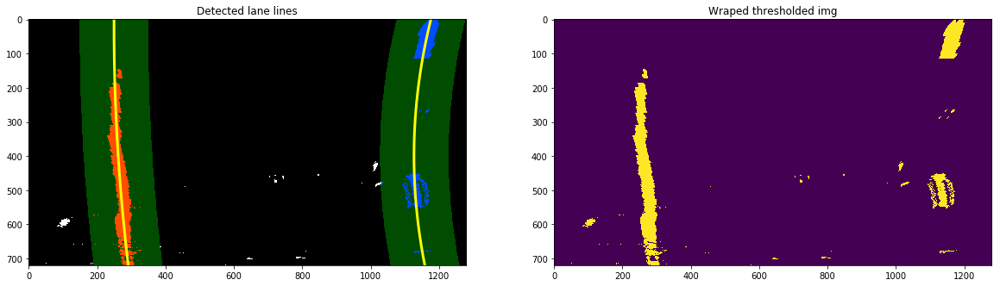

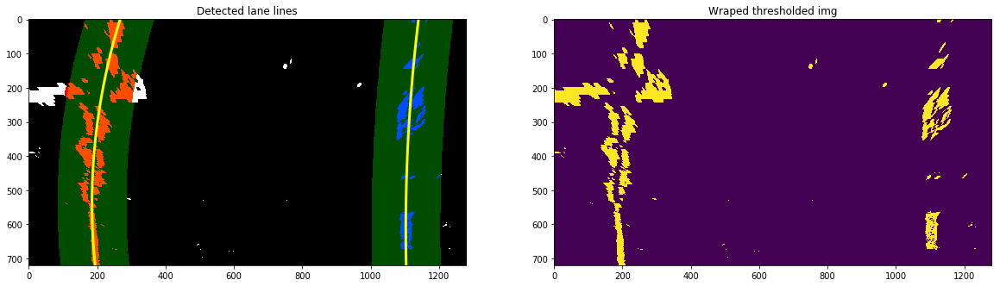

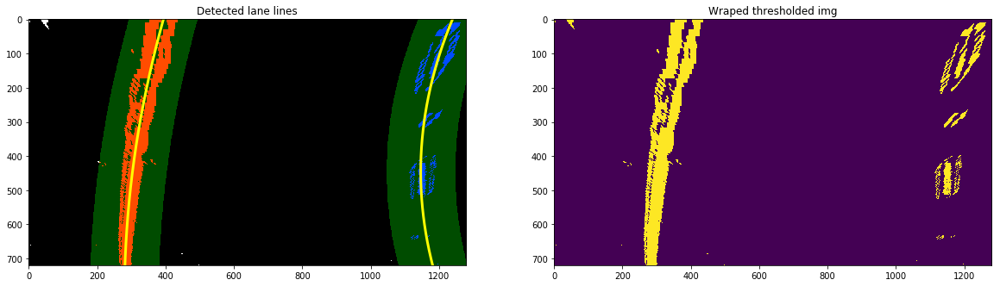

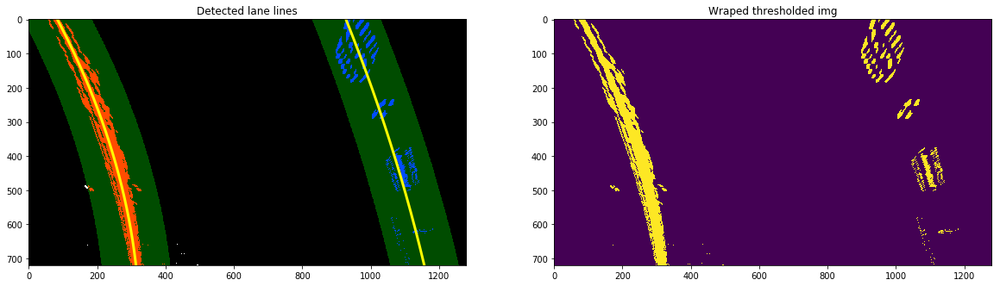

In [69]:
def search_around_poly(binary_warped):
    
    margin = 100
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin))) 
    
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # If any of the lines could not be found, 
    if (leftx.size == 0 or rightx.size == 0):
        return find_lane_pixels(binary_warped)
    
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
        
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx - margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx + margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx - margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx + margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    #plot the polynomial lines onto the image
    #plt.plot(left_fitx, ploty, color = 'yellow')
    #plt.plot(right_fitx, ploty, color = 'yellow')
    
    return result, left_fitx, right_fitx, ploty


#result, left_fitx, right_fitx, ploty = search_around_poly(warped_thresholded_img)
# plot
#plt.imshow(result)
#plt.title('Lane Line Detected')

imgs = glob.glob('./test_images/test*.jpg')
for fname in imgs:    
        # read each image
        original_img = cv2.imread(fname)
        # Converting to RGB scale
        RGB_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        # undistord the image with the informations that we calculated 
        # in the previous section
        RGB_undistorderd_img = cv2.undistort(RGB_img, mtx, dist, None, mtx)
        # computethe gradient in X 
        gradient_x_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'x', sobel_kernel = 15, thresh = (20, 100))
        # computethe gradient in Y
        gradient_y_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'y', sobel_kernel = 15, thresh = (20, 100))
        # compute the gradient magnitude
        magnitude_gradient_binary = mag_thres(RGB_undistorderd_img, sobel_kernel = 15, thresh= (60, 100))
        # compute gradient direction
        directional_gradient_binary = dir_thresh(RGB_undistorderd_img, sobel_kernel = 15, thresh=(0.7, 1.3))
        # compute color threshold
        color_threshold_binary = color_thresh(RGB_undistorderd_img, thresh = (180, 255))
        # Combined Threshold
        combined_threshod_binary = combined_threshs(gradient_x_binary, gradient_y_binary, magnitude_gradient_binary, directional_gradient_binary, color_threshold_binary, ksize = 15)
        # Warped Thresholded Img
        warped_thresholded_img, M, M_inv, src, dst = warp(combined_threshod_binary)
        # detected lane line
        out_img, left_fit, right_fit, leftx, lefty, rightx, righty = fit_polynomial(warped_thresholded_img)
        #
        result, left_fitx, right_fitx, ploty = search_around_poly(warped_thresholded_img)
        # plot
        f, axarr = plt.subplots(1, 2, figsize = (20, 20))
        axarr[0].imshow(result)
        # Plots the left and right polynomials on the lane lines
        axarr[0].plot(left_fitx, ploty, color = 'yellow', linewidth = 3)
        axarr[0].plot(right_fitx, ploty, color = "yellow", linewidth = 3)
        axarr[0].set_title('Detected lane lines')
        axarr[1].imshow(warped_thresholded_img)
        axarr[1].set_title('Wraped thresholded img')

# 6: Determine the curvature of the lane and vehicle position with respect to center.

### 6-1: Determining the Curvature of the lane line

In [26]:
def measure_curvature(left_fitx, right_fitx):
    
    left_fitx_rev = left_fitx[::-1]  # Reverse to match top-to-bottom in y
    right_fitx_rev = right_fitx[::-1]  # Reverse to match top-to-bottom in y
    
    # Define conversions in x and y from pixels space to meters
    #ym_per_pix = 30/720 # meters per pixel in y dimension
    #xm_per_pix = 3.7/700 # meters per pixel in x dimension
    ym_per_pix = 25/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/800 # meters per pixel in x dimension
    
    # Fit a second order polynomial to pixel positions
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx_rev*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx_rev*xm_per_pix, 2)                                                          

    # Fit new polynomials to x,y in world space
    y_eval = np.max(ploty)

    # Calculate the radius of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

    # Now our radius of curvature is in meters
    print(left_curverad)
    return left_curverad, right_curverad


# left and right curvature
left_curverad, right_curverad = measure_curvature(left_fitx, right_fitx)

# Print the results
print('Left line curvature:', left_curverad, 'm')
print('Right line curvature:', right_curverad, 'm')

imgs = glob.glob('./test_images/test*.jpg')
for fname in imgs:    
        # read each image
        original_img = cv2.imread(fname)
        # Converting to RGB scale
        RGB_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        # undistord the image with the informations that we calculated 
        # in the previous section
        RGB_undistorderd_img = cv2.undistort(RGB_img, mtx, dist, None, mtx)
        # computethe gradient in X 
        gradient_x_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'x', sobel_kernel = 15, thresh = (20, 100))
        # computethe gradient in Y
        gradient_y_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'y', sobel_kernel = 15, thresh = (20, 100))
        # compute the gradient magnitude
        magnitude_gradient_binary = mag_thres(RGB_undistorderd_img, sobel_kernel = 15, thresh= (60, 100))
        # compute gradient direction
        directional_gradient_binary = dir_thresh(RGB_undistorderd_img, sobel_kernel = 15, thresh=(0.7, 1.3))
        # compute color threshold
        color_threshold_binary = color_thresh(RGB_undistorderd_img, thresh = (180, 255))
        # Combined Threshold
        combined_threshod_binary = combined_threshs(gradient_x_binary, gradient_y_binary, magnitude_gradient_binary, directional_gradient_binary, color_threshold_binary, ksize = 15)
        # Warped Thresholded Img
        warped_thresholded_img, M, M_inv, src, dst = warp(combined_threshod_binary)
        # detected lane line
        out_img, left_fit, right_fit, leftx, lefty, rightx, righty = fit_polynomial(warped_thresholded_img)
        result, left_fitx, right_fitx, ploty = search_around_poly(warped_thresholded_img)
        # left and right curvature
        left_curverad, right_curverad = measure_curvature(left_fitx, right_fitx)
        print()
        print('Left line curvature:', left_curverad, 'm')
        print('Right line curvature:', right_curverad, 'm')

426.853390719
Left line curvature: 426.853390719 m
Right line curvature: 732.60487631 m


### 6-2: Compute the car offset

In [23]:
# You can assume the camera is mounted at the center of the car, 
#such that the lane center is the midpoint at the bottom of the 
#image between the two lines you've detected. 
#The offset of the lane center from the center of the image 
#(converted from pixels to meters) is your distance from the center 
# of the lane.

def car_offset(binary_warped, left_fit, right_fit):
    
    # Define conversion in x from pixels space to meters
    #xm_per_pix = 3.7/700 # meters per pixel in x dimension
    xm_per_pix = 3.7/800 # meters per pixel in x dimension
    
    # The y value of the bottom of the image 
    y_max = binary_warped.shape[0]
    
    # Left line position at the bottom of the image
    left_fit_pos = left_fit[0]*y_max**2 + left_fit[1]*y_max + left_fit[2]
    # Right line position at the bottom of the image
    right_fit_pos = right_fit[0]*y_max**2 + right_fit[1]*y_max + right_fit[2] 
    
    # Center of the lane line (in x) 
    center_lanes_x_pos = (left_fit_pos + right_fit_pos)//2
    
    # Car position WRT the lane line center
    # (the negative value means that the car is on the felt hand side of the center of the lane and vice versa)
    car_pos = ((binary_warped.shape[1]//2) - center_lanes_x_pos) * xm_per_pix 
    
    return car_pos

car_pos = car_offset(warped_thresholded_img, left_fit, right_fit)
print('Car position WRT the Lane Line center  = ', car_pos, 'm.')

Car position WRT the Lane Line center  =  -0.26825 m.


# 7: Warp the detected lane boundaries back onto the original image

Text(0.5,1,'Detected Lane')

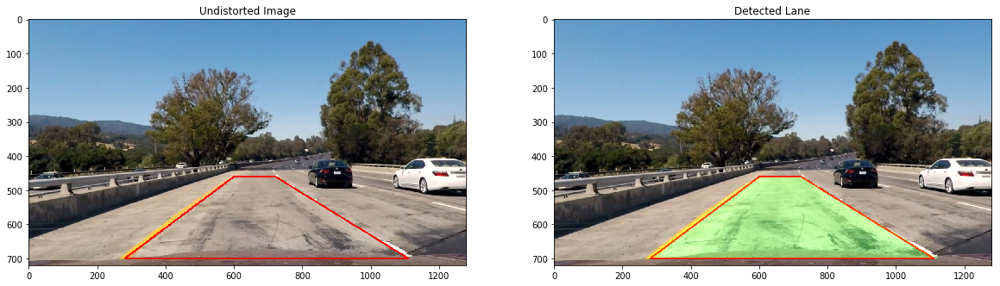

In [24]:
def print_lane(undistorted_img, warped_thresholded_img, left_fitx, right_fitx, ploty, M_inv):
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped_thresholded_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, M_inv, (undistorted_img.shape[1], undistorted_img.shape[0])) 

    # Combine the result with the original image
    lane = cv2.addWeighted(undistorted_img, 1, newwarp, 0.3, 0)
    return lane


# Run the function
lane = print_lane(RGB_undistorderd_img, warped_thresholded_img, left_fitx, right_fitx, ploty, M_inv)

# plot
f, axarr = plt.subplots(1, 2, figsize = (20, 20))
axarr[0].imshow(RGB_undistorderd_img)
axarr[0].set_title('Undistorted Image')
axarr[1].imshow(lane)
axarr[1].set_title('Detected Lane')

# 8: Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


printf
-0.26825
537.756833883
923.013507081
--------


Text(0.5,1,'Detected Lane')

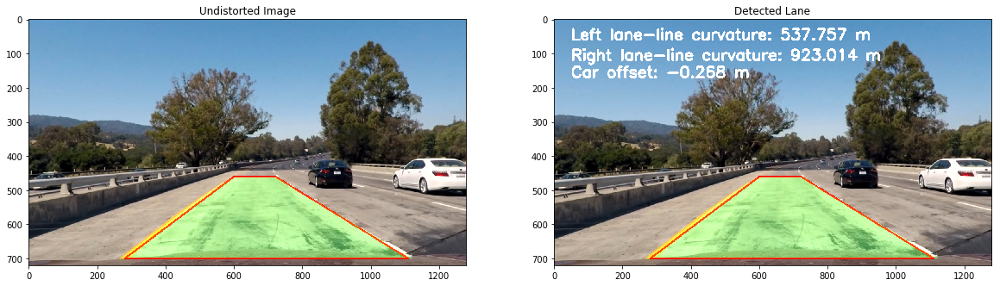

In [25]:
#def print_inf(img, binary_warped, leftx, rightx):
def print_inf(img, left_curverad, right_curverad, car_pos):
    print("printf")
    
    # Curvature
    #left_curverad, right_curverad = measure_curvature(left_fitx, right_fitx)
    
    # Car offset
    #car_pos = car_offset(binary_warped, left_fit, right_fit)
    
    # Copy the original image to wrtite on it
    out_img = img.copy()
    
    print(car_pos)
    print(left_curverad)
    print(right_curverad)
    print("--------")
    
    # Display Curvature information
    cv2.putText(out_img, 'Left lane-line curvature: {:.3f} m'.format(left_curverad), (50, 60), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 5)
    cv2.putText(out_img, 'Right lane-line curvature: {:.3f} m'.format(right_curverad), (50, 120), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 5)
    # Display Car offset information 
    cv2.putText(out_img, 'Car offset: {:.3f} m'.format(car_pos), (50, 170), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 5)
    
    return out_img

# Run the function
#out_img = print_inf(lane, warped_thresholded_img, leftx, rightx)
out_img = print_inf(lane, left_curverad, right_curverad, car_pos)

# plot
f, axarr = plt.subplots(1, 2, figsize = (20, 20))
axarr[0].imshow(lane)
axarr[0].set_title('Undistorted Image')
axarr[1].imshow(out_img)
axarr[1].set_title('Detected Lane')

# PipeLine

In [21]:
# pipeline
class PipeLine:
    def __init__(self, imgs):
        
        # Gathering all images for calibrating camera in a list
        calibrating_images = glob.glob(imgs)

        # Calibrating the camera
        self.ret, self.mtx, self.dist, self.rvecs, self.tvecs = calibrate_camera(calibrating_images)
        
    def __call__(self, img):
        
        # Undistord image
        RGB_undistorderd_img = cv2.undistort(img, mtx, dist, None, mtx)

        # Calculate directional gradient
        gradient_x_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'x', sobel_kernel = 15, thresh = (20, 100))
        gradient_y_binary = abs_sobel_thresh(RGB_undistorderd_img, orient = 'y', sobel_kernel = 15, thresh = (20, 100))
        # Calculate gradient magnitude 
        magnitude_gradient_binary = mag_thres(RGB_undistorderd_img, sobel_kernel = 15, thresh= (60, 100))
        # Calculate gradient direction
        directional_gradient_binary = dir_thresh(RGB_undistorderd_img, sobel_kernel = 15, thresh=(0.7, 1.3))
        # Calculate color threshold
        color_threshold_binary = color_thresh(RGB_undistorderd_img, thresh = (180, 255))
        # Combine all the thresholds to identify the lane lines
        combined_threshod_binary = combined_threshs(gradient_x_binary, gradient_y_binary, magnitude_gradient_binary, directional_gradient_binary, color_threshold_binary, ksize = 15)
  
        # Apply a perspective transform to rectify binary image ("birds-eye view")
        #warped_img, M, M_inv, src, dst = warp(RGB_undistorderd_img)
        
        # Warped Thresholded Image 
        warped_thresholded_img, M, M_inv, src, dst = warp(combined_threshod_binary)
        
        # Fit Polynomial 
        fit_polynomial_img, left_fit, right_fit, leftx, lefty, rightx, righty = fit_polynomial(warped_thresholded_img)
        result, left_fitx, right_fitx, ploty = search_around_poly(warped_thresholded_img)
        
        # Lane Curvature and carr offset
        left_curverad, right_curverad = measure_curvature(left_fitx, right_fitx)
        print("---")
        print(left_curverad)
        car_pos = car_offset(warped_thresholded_img, left_fit, right_fit)
        
        # Detected Lane
        lane = print_lane(RGB_undistorderd_img, warped_thresholded_img, left_fitx, right_fitx, ploty, M_inv)
        #binary_img = print_inf(lane, warped_thresholded_img, leftx, rightx)
        binary_img = print_inf(lane, left_curverad, right_curverad, car_pos)
        
        return binary_img     
        
        

604.441134175
---
604.441134175
printf
-0.444
604.441134175
675.400530211
--------
[MoviePy] >>>> Building video ./project_video_lane_line_detection.mp4
[MoviePy] Writing video ./project_video_lane_line_detection.mp4



  0%|          | 1/1261 [00:00<07:46,  2.70it/s]

604.441134175
---
604.441134175
printf
-0.444
604.441134175
675.400530211
--------



  0%|          | 2/1261 [00:00<07:52,  2.66it/s]

569.718221816
---
569.718221816
printf
-0.430125
569.718221816
436.3270905
--------



  0%|          | 3/1261 [00:01<07:52,  2.66it/s]

473.806561151
---
473.806561151
printf
-0.411625
473.806561151
303.325561484
--------



  0%|          | 4/1261 [00:01<07:50,  2.67it/s]

414.345341764
---
414.345341764
printf
-0.420875
414.345341764
333.772191287
--------



  0%|          | 5/1261 [00:01<07:49,  2.68it/s]

454.61011416
---
454.61011416
printf
-0.430125
454.61011416
371.074030088
--------



  0%|          | 6/1261 [00:02<07:52,  2.65it/s]

501.394322597
---
501.394322597
printf
-0.448625
501.394322597
238.481954317
--------



  1%|          | 7/1261 [00:02<07:50,  2.66it/s]

697.259880773
---
697.259880773
printf
-0.457875
697.259880773
327.466607252
--------



  1%|          | 8/1261 [00:03<07:53,  2.65it/s]

661.003040958
---
661.003040958
printf
-0.60125
661.003040958
464.67532778
--------



  1%|          | 9/1261 [00:03<07:53,  2.64it/s]

853.734657545
---
853.734657545
printf
-0.642875
853.734657545
5800.74655069
--------



  1%|          | 10/1261 [00:03<07:55,  2.63it/s]

676.700502967
---
676.700502967
printf
-0.568875
676.700502967
12929.9113961
--------



  1%|          | 11/1261 [00:04<07:52,  2.65it/s]

600.138258609
---
600.138258609
printf
-0.49025
600.138258609
1151.86382319
--------



  1%|          | 12/1261 [00:04<07:54,  2.63it/s]

678.139194753
---
678.139194753
printf
-0.5365
678.139194753
12337.9904897
--------



  1%|          | 13/1261 [00:04<07:50,  2.65it/s]

727.256771919
---
727.256771919
printf
-0.4995
727.256771919
300.457694902
--------



  1%|          | 14/1261 [00:05<07:45,  2.68it/s]

594.347685745
---
594.347685745
printf
-0.467125
594.347685745
328.152887672
--------



  1%|          | 15/1261 [00:05<07:49,  2.65it/s]

627.345682874
---
627.345682874
printf
-0.444
627.345682874
423.789030285
--------



  1%|▏         | 16/1261 [00:06<07:50,  2.65it/s]

584.97869037
---
584.97869037
printf
-0.439375
584.97869037
327.04804072
--------



  1%|▏         | 17/1261 [00:06<07:49,  2.65it/s]

908.650685226
---
908.650685226
printf
-0.439375
908.650685226
296.811243186
--------



  1%|▏         | 18/1261 [00:06<07:48,  2.65it/s]

1220.17447574
---
1220.17447574
printf
-0.439375
1220.17447574
243.21350578
--------



  2%|▏         | 19/1261 [00:07<07:47,  2.66it/s]

2054.47714807
---
2054.47714807
printf
-0.439375
2054.47714807
205.924062901
--------



  2%|▏         | 20/1261 [00:07<07:48,  2.65it/s]

8949.22189717
---
8949.22189717
printf
-0.41625
8949.22189717
168.086030865
--------



  2%|▏         | 21/1261 [00:07<07:49,  2.64it/s]

2774.08787826
---
2774.08787826
printf
-0.541125
2774.08787826
141.524600927
--------



  2%|▏         | 22/1261 [00:08<07:49,  2.64it/s]

2413.15787378
---
2413.15787378
printf
-0.504125
2413.15787378
796.655726135
--------



  2%|▏         | 23/1261 [00:08<07:50,  2.63it/s]

1132.62223392
---
1132.62223392
printf
-0.485625
1132.62223392
2144.06868503
--------



  2%|▏         | 24/1261 [00:09<07:50,  2.63it/s]

1381.08344856
---
1381.08344856
printf
-0.4255
1381.08344856
977.942830304
--------



  2%|▏         | 25/1261 [00:09<07:52,  2.61it/s]

7307.18324772
---
7307.18324772
printf
-0.411625
7307.18324772
852.077615793
--------



  2%|▏         | 26/1261 [00:09<07:51,  2.62it/s]

9139.47482761
---
9139.47482761
printf
-0.402375
9139.47482761
491.916067467
--------



  2%|▏         | 27/1261 [00:10<07:53,  2.61it/s]

4974.94796929
---
4974.94796929
printf
-0.37925
4974.94796929
759.228162394
--------



  2%|▏         | 28/1261 [00:10<07:50,  2.62it/s]

8656.70406347
---
8656.70406347
printf
-0.374625
8656.70406347
811.127086548
--------



  2%|▏         | 29/1261 [00:10<07:49,  2.62it/s]

1824.65627885
---
1824.65627885
printf
-0.365375
1824.65627885
533.442810632
--------



  2%|▏         | 30/1261 [00:11<07:58,  2.57it/s]

1808.18506887
---
1808.18506887
printf
-0.36075
1808.18506887
299.211157176
--------



  2%|▏         | 31/1261 [00:12<09:23,  2.18it/s]

840.096331132
---
840.096331132
printf
-0.365375
840.096331132
241.666160924
--------



  3%|▎         | 32/1261 [00:12<09:35,  2.14it/s]

716.981106551
---
716.981106551
printf
-0.365375
716.981106551
231.463398731
--------



  3%|▎         | 33/1261 [00:12<09:02,  2.26it/s]

1008.55535872
---
1008.55535872
printf
-0.4255
1008.55535872
406.15898819
--------



  3%|▎         | 34/1261 [00:13<08:36,  2.38it/s]

1015.11989262
---
1015.11989262
printf
-0.52725
1015.11989262
1367.22953226
--------



  3%|▎         | 35/1261 [00:13<08:16,  2.47it/s]

861.911799595
---
861.911799595
printf
-0.50875
861.911799595
1254.41748304
--------



  3%|▎         | 36/1261 [00:13<08:05,  2.52it/s]

648.229992694
---
648.229992694
printf
-0.383875
648.229992694
1286.27099947
--------



  3%|▎         | 37/1261 [00:14<07:59,  2.55it/s]

544.873295439
---
544.873295439
printf
-0.41625
544.873295439
1126.89198892
--------



  3%|▎         | 38/1261 [00:14<07:51,  2.59it/s]

474.612494306
---
474.612494306
printf
-0.37925
474.612494306
280.763754268
--------



  3%|▎         | 39/1261 [00:15<07:46,  2.62it/s]

464.839947689
---
464.839947689
printf
-0.356125
464.839947689
1920.84993436
--------



  3%|▎         | 40/1261 [00:15<07:44,  2.63it/s]

391.615149455
---
391.615149455
printf
-0.3515
391.615149455
514.238949712
--------



  3%|▎         | 41/1261 [00:15<07:44,  2.62it/s]

386.74328003
---
386.74328003
printf
-0.37
386.74328003
471.125770721
--------



  3%|▎         | 42/1261 [00:16<07:44,  2.63it/s]

391.984626409
---
391.984626409
printf
-0.374625
391.984626409
590.180334243
--------



  3%|▎         | 43/1261 [00:16<09:33,  2.13it/s]

427.871710887
---
427.871710887
printf
-0.3885
427.871710887
314.637981769
--------



  3%|▎         | 44/1261 [00:17<09:22,  2.16it/s]

460.953372882
---
460.953372882
printf
-0.39775
460.953372882
324.500334883
--------



  4%|▎         | 45/1261 [00:17<10:05,  2.01it/s]

424.224486725
---
424.224486725
printf
-0.407
424.224486725
250.339178395
--------



  4%|▎         | 46/1261 [00:18<10:04,  2.01it/s]

441.717144603
---
441.717144603
printf
-0.439375
441.717144603
278.368228284
--------



  4%|▎         | 47/1261 [00:18<09:39,  2.09it/s]

526.297147324
---
526.297147324
printf
-0.541125
526.297147324
3611.34104912
--------



  4%|▍         | 48/1261 [00:19<09:38,  2.10it/s]

575.70150074
---
575.70150074
printf
-0.481
575.70150074
99065.5940749
--------



  4%|▍         | 49/1261 [00:19<09:20,  2.16it/s]

658.229676119
---
658.229676119
printf
-0.4625
658.229676119
818.997662071
--------



  4%|▍         | 50/1261 [00:20<09:29,  2.13it/s]

550.75527063
---
550.75527063
printf
-0.467125
550.75527063
418.870372593
--------



  4%|▍         | 51/1261 [00:20<09:16,  2.17it/s]

550.893419813
---
550.893419813
printf
-0.45325
550.893419813
582.851988001
--------



  4%|▍         | 52/1261 [00:21<09:24,  2.14it/s]

475.202557125
---
475.202557125
printf
-0.3885
475.202557125
523.136924999
--------



  4%|▍         | 53/1261 [00:21<09:12,  2.18it/s]

456.099215501
---
456.099215501
printf
-0.3885
456.099215501
817.137781141
--------



  4%|▍         | 54/1261 [00:22<09:24,  2.14it/s]

470.73384092
---
470.73384092
printf
-0.39775
470.73384092
722.443558209
--------



  4%|▍         | 55/1261 [00:22<09:12,  2.18it/s]

907.97628245
---
907.97628245
printf
-0.402375
907.97628245
510.170678653
--------



  4%|▍         | 56/1261 [00:23<09:21,  2.15it/s]

1533.31964655
---
1533.31964655
printf
-0.407
1533.31964655
329.372339708
--------



  5%|▍         | 57/1261 [00:23<09:07,  2.20it/s]

3648.07607804
---
3648.07607804
printf
-0.407
3648.07607804
198.945750066
--------



  5%|▍         | 58/1261 [00:23<09:19,  2.15it/s]

12275.9968232
---
12275.9968232
printf
-0.444
12275.9968232
531.852203289
--------



  5%|▍         | 59/1261 [00:24<09:06,  2.20it/s]

2315.5532421
---
2315.5532421
printf
-0.50875
2315.5532421
148.270464475
--------



  5%|▍         | 60/1261 [00:24<09:18,  2.15it/s]

3369.89006727
---
3369.89006727
printf
-0.39775
3369.89006727
201.283226819
--------



  5%|▍         | 61/1261 [00:25<09:11,  2.18it/s]

4486.25088669
---
4486.25088669
printf
-0.411625
4486.25088669
255.138072768
--------



  5%|▍         | 62/1261 [00:26<10:30,  1.90it/s]

7398.55114741
---
7398.55114741
printf
-0.37925
7398.55114741
635.853194359
--------



  5%|▍         | 63/1261 [00:26<10:58,  1.82it/s]

4465.30100736
---
4465.30100736
printf
-0.337625
4465.30100736
1469.16037416
--------



  5%|▌         | 64/1261 [00:27<10:39,  1.87it/s]

1455.85910112
---
1455.85910112
printf
-0.337625
1455.85910112
5510.94551935
--------



  5%|▌         | 65/1261 [00:27<10:06,  1.97it/s]

1101.01158108
---
1101.01158108
printf
-0.333
1101.01158108
793.849573401
--------



  5%|▌         | 66/1261 [00:28<09:56,  2.00it/s]

751.0135647
---
751.0135647
printf
-0.32375
751.0135647
694.031180151
--------



  5%|▌         | 67/1261 [00:28<10:16,  1.94it/s]

749.72967579
---
749.72967579
printf
-0.319125
749.72967579
515.078488384
--------



  5%|▌         | 68/1261 [00:29<10:07,  1.96it/s]

855.248550107
---
855.248550107
printf
-0.319125
855.248550107
464.003025029
--------



  5%|▌         | 69/1261 [00:29<09:39,  2.06it/s]

917.770964566
---
917.770964566
printf
-0.32375
917.770964566
383.4294536
--------



  6%|▌         | 70/1261 [00:30<09:39,  2.06it/s]

892.102635232
---
892.102635232
printf
-0.411625
892.102635232
283.427712416
--------



  6%|▌         | 71/1261 [00:30<09:20,  2.12it/s]

1089.53057238
---
1089.53057238
printf
-0.383875
1089.53057238
92.6489420944
--------



  6%|▌         | 72/1261 [00:30<09:30,  2.08it/s]

1158.33833465
---
1158.33833465
printf
-0.328375
1158.33833465
124.89431402
--------



  6%|▌         | 73/1261 [00:31<09:21,  2.12it/s]

1521.51320116
---
1521.51320116
printf
-0.300625
1521.51320116
111.614655764
--------



  6%|▌         | 74/1261 [00:31<09:29,  2.08it/s]

2198.49073619
---
2198.49073619
printf
-0.319125
2198.49073619
297.42683759
--------



  6%|▌         | 75/1261 [00:32<09:13,  2.14it/s]

2117.94668563
---
2117.94668563
printf
-0.291375
2117.94668563
520.009333425
--------



  6%|▌         | 76/1261 [00:32<09:20,  2.11it/s]

23929.1188687
---
23929.1188687
printf
-0.282125
23929.1188687
4928.94137056
--------



  6%|▌         | 77/1261 [00:33<09:11,  2.15it/s]

3165.9204211
---
3165.9204211
printf
-0.2775
3165.9204211
522.734893658
--------



  6%|▌         | 78/1261 [00:33<09:22,  2.10it/s]

3105.39597751
---
3105.39597751
printf
-0.263625
3105.39597751
504.927094372
--------



  6%|▋         | 79/1261 [00:34<09:11,  2.14it/s]

1354.04129094
---
1354.04129094
printf
-0.259
1354.04129094
602.56727361
--------



  6%|▋         | 80/1261 [00:34<09:22,  2.10it/s]

1164.67718749
---
1164.67718749
printf
-0.254375
1164.67718749
870.443263081
--------



  6%|▋         | 81/1261 [00:35<09:13,  2.13it/s]

752.406588205
---
752.406588205
printf
-0.259
752.406588205
462.61729638
--------



  7%|▋         | 82/1261 [00:35<09:16,  2.12it/s]

683.510310818
---
683.510310818
printf
-0.24975
683.510310818
290.950349506
--------



  7%|▋         | 83/1261 [00:36<09:03,  2.17it/s]

663.370068102
---
663.370068102
printf
-0.26825
663.370068102
214.740871459
--------



  7%|▋         | 84/1261 [00:36<09:15,  2.12it/s]

639.633291314
---
639.633291314
printf
-0.28675
639.633291314
228.296968849
--------



  7%|▋         | 85/1261 [00:37<09:00,  2.17it/s]

623.354073657
---
623.354073657
printf
-0.365375
623.354073657
478.704619703
--------



  7%|▋         | 86/1261 [00:37<09:10,  2.14it/s]

635.446317491
---
635.446317491
printf
-0.333
635.446317491
1094.92050579
--------



  7%|▋         | 87/1261 [00:37<09:04,  2.16it/s]

988.659730003
---
988.659730003
printf
-0.28675
988.659730003
3739.23983441
--------



  7%|▋         | 88/1261 [00:38<09:15,  2.11it/s]

2560.29401098
---
2560.29401098
printf
-0.259
2560.29401098
1740.43441575
--------



  7%|▋         | 89/1261 [00:38<09:06,  2.14it/s]

79260.0035302
---
79260.0035302
printf
-0.17575
79260.0035302
2698.68535521
--------



  7%|▋         | 90/1261 [00:39<09:19,  2.09it/s]

1841.15934831
---
1841.15934831
printf
-0.198875
1841.15934831
1323.09602695
--------



  7%|▋         | 91/1261 [00:39<09:08,  2.13it/s]

1703.95754476
---
1703.95754476
printf
-0.21275
1703.95754476
584.48819824
--------



  7%|▋         | 92/1261 [00:40<09:21,  2.08it/s]

1697.20980834
---
1697.20980834
printf
-0.222
1697.20980834
647.133288376
--------



  7%|▋         | 93/1261 [00:40<09:09,  2.12it/s]

1206.83853742
---
1206.83853742
printf
-0.23125
1206.83853742
588.653150787
--------



  7%|▋         | 94/1261 [00:41<09:16,  2.10it/s]

1022.71472658
---
1022.71472658
printf
-0.2405
1022.71472658
402.926182045
--------



  8%|▊         | 95/1261 [00:41<09:06,  2.13it/s]

1172.27174044
---
1172.27174044
printf
-0.226625
1172.27174044
246.903744021
--------



  8%|▊         | 96/1261 [00:42<09:13,  2.10it/s]

998.56013341
---
998.56013341
printf
-0.3885
998.56013341
135.669462471
--------



  8%|▊         | 97/1261 [00:42<09:05,  2.13it/s]

994.151736503
---
994.151736503
printf
-0.37925
994.151736503
128.597760241
--------



  8%|▊         | 98/1261 [00:43<09:13,  2.10it/s]

939.876665664
---
939.876665664
printf
-0.28675
939.876665664
234.577959996
--------



  8%|▊         | 99/1261 [00:43<09:02,  2.14it/s]

914.56408001
---
914.56408001
printf
-0.23125
914.56408001
446.72828397
--------



  8%|▊         | 100/1261 [00:44<09:12,  2.10it/s]

1097.69417588
---
1097.69417588
printf
-0.23125
1097.69417588
804.270774047
--------



  8%|▊         | 101/1261 [00:44<09:03,  2.13it/s]

1264.9671652
---
1264.9671652
printf
-0.235875
1264.9671652
813.457932739
--------



  8%|▊         | 102/1261 [00:45<09:18,  2.08it/s]

1030.50500491
---
1030.50500491
printf
-0.222
1030.50500491
620.780040726
--------



  8%|▊         | 103/1261 [00:45<09:07,  2.12it/s]

1143.2091824
---
1143.2091824
printf
-0.23125
1143.2091824
844.258127879
--------



  8%|▊         | 104/1261 [00:46<09:13,  2.09it/s]

1096.68761924
---
1096.68761924
printf
-0.2405
1096.68761924
592.173639195
--------



  8%|▊         | 105/1261 [00:46<09:56,  1.94it/s]

1312.96960071
---
1312.96960071
printf
-0.245125
1312.96960071
664.742325434
--------



  8%|▊         | 106/1261 [00:47<09:33,  2.01it/s]

1744.37546907
---
1744.37546907
printf
-0.259
1744.37546907
455.630678874
--------



  8%|▊         | 107/1261 [00:47<09:40,  1.99it/s]

1344.64573562
---
1344.64573562
printf
-0.26825
1344.64573562
335.327335559
--------



  9%|▊         | 108/1261 [00:48<09:24,  2.04it/s]

1851.64377546
---
1851.64377546
printf
-0.296
1851.64377546
282.842183483
--------



  9%|▊         | 109/1261 [00:48<09:29,  2.02it/s]

1772.06819919
---
1772.06819919
printf
-0.3145
1772.06819919
281.968845876
--------



  9%|▊         | 110/1261 [00:49<09:12,  2.08it/s]

1756.39508251
---
1756.39508251
printf
-0.439375
1756.39508251
725.766256981
--------



  9%|▉         | 111/1261 [00:49<09:19,  2.06it/s]

1079.46218514
---
1079.46218514
printf
-0.374625
1079.46218514
1762.55871462
--------



  9%|▉         | 112/1261 [00:49<09:05,  2.11it/s]

1295.60503038
---
1295.60503038
printf
-0.356125
1295.60503038
1435.65077918
--------



  9%|▉         | 113/1261 [00:50<09:16,  2.06it/s]

816.669051438
---
816.669051438
printf
-0.32375
816.669051438
1281.35552781
--------



  9%|▉         | 114/1261 [00:50<09:00,  2.12it/s]

696.160958175
---
696.160958175
printf
-0.319125
696.160958175
592.06381133
--------



  9%|▉         | 115/1261 [00:51<09:11,  2.08it/s]

592.830112379
---
592.830112379
printf
-0.2775
592.830112379
553.35103915
--------



  9%|▉         | 116/1261 [00:51<09:00,  2.12it/s]

533.49004755
---
533.49004755
printf
-0.296
533.49004755
584.191086691
--------



  9%|▉         | 117/1261 [00:52<09:09,  2.08it/s]

510.361996808
---
510.361996808
printf
-0.30525
510.361996808
683.488440272
--------



  9%|▉         | 118/1261 [00:52<09:00,  2.11it/s]

589.466268521
---
589.466268521
printf
-0.3145
589.466268521
427.438678287
--------



  9%|▉         | 119/1261 [00:53<09:10,  2.07it/s]

736.840373179
---
736.840373179
printf
-0.328375
736.840373179
313.064064143
--------



 10%|▉         | 120/1261 [00:53<09:05,  2.09it/s]

680.525123516
---
680.525123516
printf
-0.333
680.525123516
239.901290144
--------



 10%|▉         | 121/1261 [00:54<09:11,  2.07it/s]

679.055170673
---
679.055170673
printf
-0.407
679.055170673
231.729662325
--------



 10%|▉         | 122/1261 [00:54<09:57,  1.91it/s]

591.136782976
---
591.136782976
printf
-0.448625
591.136782976
203.868066461
--------



 10%|▉         | 123/1261 [00:55<09:32,  1.99it/s]

543.344286284
---
543.344286284
printf
-0.34225
543.344286284
764.990181792
--------



 10%|▉         | 124/1261 [00:55<09:30,  1.99it/s]

522.630071586
---
522.630071586
printf
-0.39775
522.630071586
2723.88460503
--------



 10%|▉         | 125/1261 [00:56<09:11,  2.06it/s]

512.950378777
---
512.950378777
printf
-0.37925
512.950378777
950.220252799
--------



 10%|▉         | 126/1261 [00:56<09:13,  2.05it/s]

541.452116319
---
541.452116319
printf
-0.383875
541.452116319
322.201372461
--------



 10%|█         | 127/1261 [00:57<08:58,  2.11it/s]

494.072018427
---
494.072018427
printf
-0.34225
494.072018427
1282.3876858
--------



 10%|█         | 128/1261 [00:57<09:07,  2.07it/s]

509.196807058
---
509.196807058
printf
-0.37
509.196807058
1838.95451275
--------



 10%|█         | 129/1261 [00:58<08:56,  2.11it/s]

476.162176468
---
476.162176468
printf
-0.374625
476.162176468
2662.52314463
--------



 10%|█         | 130/1261 [00:58<09:08,  2.06it/s]

497.482160501
---
497.482160501
printf
-0.374625
497.482160501
752.551918813
--------



 10%|█         | 131/1261 [00:59<08:58,  2.10it/s]

624.939721183
---
624.939721183
printf
-0.393125
624.939721183
615.051290127
--------



 10%|█         | 132/1261 [00:59<09:10,  2.05it/s]

570.517180559
---
570.517180559
printf
-0.402375
570.517180559
324.053881393
--------



 11%|█         | 133/1261 [01:00<09:04,  2.07it/s]

597.646445616
---
597.646445616
printf
-0.430125
597.646445616
321.072032525
--------



 11%|█         | 134/1261 [01:00<09:04,  2.07it/s]

613.101072042
---
613.101072042
printf
-0.49025
613.101072042
247.429778528
--------



 11%|█         | 135/1261 [01:01<09:20,  2.01it/s]

624.017080155
---
624.017080155
printf
-0.444
624.017080155
671.719285448
--------



 11%|█         | 136/1261 [01:01<09:05,  2.06it/s]

670.994512908
---
670.994512908
printf
-0.407
670.994512908
1270.80683451
--------



 11%|█         | 137/1261 [01:02<09:10,  2.04it/s]

762.076544854
---
762.076544854
printf
-0.47175
762.076544854
792.464338099
--------



 11%|█         | 138/1261 [01:02<08:58,  2.09it/s]

711.725244901
---
711.725244901
printf
-0.4625
711.725244901
489.564474631
--------



 11%|█         | 139/1261 [01:03<09:06,  2.05it/s]

684.590155114
---
684.590155114
printf
-0.448625
684.590155114
1194.42769228
--------



 11%|█         | 140/1261 [01:03<08:54,  2.10it/s]

836.122904224
---
836.122904224
printf
-0.420875
836.122904224
1043.61299034
--------



 11%|█         | 141/1261 [01:04<09:04,  2.06it/s]

739.111369647
---
739.111369647
printf
-0.411625
739.111369647
840.825054898
--------



 11%|█▏        | 142/1261 [01:04<08:56,  2.09it/s]

776.222439361
---
776.222439361
printf
-0.402375
776.222439361
705.459216001
--------



 11%|█▏        | 143/1261 [01:05<09:05,  2.05it/s]

1002.43660397
---
1002.43660397
printf
-0.411625
1002.43660397
462.478447008
--------



 11%|█▏        | 144/1261 [01:05<08:51,  2.10it/s]

1261.16942287
---
1261.16942287
printf
-0.411625
1261.16942287
295.384037217
--------



 11%|█▏        | 145/1261 [01:05<09:03,  2.05it/s]

1462.21808918
---
1462.21808918
printf
-0.41625
1462.21808918
262.360177881
--------



 12%|█▏        | 146/1261 [01:06<08:49,  2.10it/s]

1165.32854097
---
1165.32854097
printf
-0.50875
1165.32854097
452.819470593
--------



 12%|█▏        | 147/1261 [01:06<09:00,  2.06it/s]

1137.53896516
---
1137.53896516
printf
-0.56425
1137.53896516
438.629527332
--------



 12%|█▏        | 148/1261 [01:07<08:50,  2.10it/s]

911.596706585
---
911.596706585
printf
-0.39775
911.596706585
390.824523103
--------



 12%|█▏        | 149/1261 [01:07<08:57,  2.07it/s]

848.021617972
---
848.021617972
printf
-0.41625
848.021617972
3077.33639085
--------



 12%|█▏        | 150/1261 [01:08<08:50,  2.09it/s]

1009.7829127
---
1009.7829127
printf
-0.41625
1009.7829127
8353.46809313
--------



 12%|█▏        | 151/1261 [01:08<08:57,  2.06it/s]

1162.32588998
---
1162.32588998
printf
-0.3885
1162.32588998
629.046979466
--------



 12%|█▏        | 152/1261 [01:09<08:49,  2.10it/s]

1384.32191425
---
1384.32191425
printf
-0.34225
1384.32191425
478.547568169
--------



 12%|█▏        | 153/1261 [01:09<09:40,  1.91it/s]

1174.83890672
---
1174.83890672
printf
-0.36075
1174.83890672
423.736561419
--------



 12%|█▏        | 154/1261 [01:10<09:19,  1.98it/s]

1289.0160348
---
1289.0160348
printf
-0.37
1289.0160348
399.480790138
--------



 12%|█▏        | 155/1261 [01:10<09:13,  2.00it/s]

2461.14781205
---
2461.14781205
printf
-0.383875
2461.14781205
451.608090787
--------



 12%|█▏        | 156/1261 [01:11<08:55,  2.06it/s]

2914.7355849
---
2914.7355849
printf
-0.37925
2914.7355849
328.137136866
--------



 12%|█▏        | 157/1261 [01:11<09:02,  2.03it/s]

3141.58446687
---
3141.58446687
printf
-0.383875
3141.58446687
251.922683385
--------



 13%|█▎        | 158/1261 [01:12<08:49,  2.08it/s]

1955.42046478
---
1955.42046478
printf
-0.41625
1955.42046478
320.033515106
--------



 13%|█▎        | 159/1261 [01:12<08:54,  2.06it/s]

2048.55555776
---
2048.55555776
printf
-0.578125
2048.55555776
349.975678807
--------



 13%|█▎        | 160/1261 [01:13<08:44,  2.10it/s]

1165.37060235
---
1165.37060235
printf
-0.420875
1165.37060235
176.807409344
--------



 13%|█▎        | 161/1261 [01:13<08:48,  2.08it/s]

1174.95437536
---
1174.95437536
printf
-0.393125
1174.95437536
16478.1855474
--------



 13%|█▎        | 162/1261 [01:14<08:40,  2.11it/s]

1018.26740188
---
1018.26740188
printf
-0.402375
1018.26740188
519.925457575
--------



 13%|█▎        | 163/1261 [01:14<08:51,  2.07it/s]

981.022792853
---
981.022792853
printf
-0.402375
981.022792853
330.638327639
--------



 13%|█▎        | 164/1261 [01:15<09:19,  1.96it/s]

816.362448762
---
816.362448762
printf
-0.3885
816.362448762
432.360128803
--------



 13%|█▎        | 165/1261 [01:15<09:15,  1.97it/s]

690.262612744
---
690.262612744
printf
-0.328375
690.262612744
623.955064953
--------



 13%|█▎        | 166/1261 [01:16<08:59,  2.03it/s]

711.206907264
---
711.206907264
printf
-0.328375
711.206907264
361.571778034
--------



 13%|█▎        | 167/1261 [01:16<09:02,  2.01it/s]

661.887887354
---
661.887887354
printf
-0.333
661.887887354
418.126250583
--------



 13%|█▎        | 168/1261 [01:17<08:49,  2.07it/s]

931.159168003
---
931.159168003
printf
-0.34225
931.159168003
333.755852058
--------



 13%|█▎        | 169/1261 [01:17<08:53,  2.05it/s]

1044.05243787
---
1044.05243787
printf
-0.346875
1044.05243787
230.92204071
--------



 13%|█▎        | 170/1261 [01:18<08:41,  2.09it/s]

928.714764704
---
928.714764704
printf
-0.34225
928.714764704
216.89362986
--------



 14%|█▎        | 171/1261 [01:18<08:49,  2.06it/s]

1169.95586996
---
1169.95586996
printf
-0.328375
1169.95586996
171.861148098
--------



 14%|█▎        | 172/1261 [01:19<08:44,  2.08it/s]

1426.93913448
---
1426.93913448
printf
-0.476375
1426.93913448
195.510489636
--------



 14%|█▎        | 173/1261 [01:19<08:55,  2.03it/s]

2326.70466825
---
2326.70466825
printf
-0.34225
2326.70466825
681.444874579
--------



 14%|█▍        | 174/1261 [01:20<08:45,  2.07it/s]

2170.7063772
---
2170.7063772
printf
-0.32375
2170.7063772
672.424041012
--------



 14%|█▍        | 175/1261 [01:20<08:49,  2.05it/s]

2734.43601464
---
2734.43601464
printf
-0.282125
2734.43601464
20643.4307923
--------



 14%|█▍        | 176/1261 [01:21<08:37,  2.10it/s]

7348.63027953
---
7348.63027953
printf
-0.226625
7348.63027953
743.227486286
--------



 14%|█▍        | 177/1261 [01:21<08:48,  2.05it/s]

8947.31826153
---
8947.31826153
printf
-0.208125
8947.31826153
15126.6655685
--------



 14%|█▍        | 178/1261 [01:22<08:40,  2.08it/s]

4604.60963581
---
4604.60963581
printf
-0.259
4604.60963581
857.645228576
--------



 14%|█▍        | 179/1261 [01:22<08:50,  2.04it/s]

5456.34666483
---
5456.34666483
printf
-0.2775
5456.34666483
1185.52336831
--------



 14%|█▍        | 180/1261 [01:23<08:44,  2.06it/s]

1370.31986978
---
1370.31986978
printf
-0.282125
1370.31986978
1173.84943454
--------



 14%|█▍        | 181/1261 [01:23<08:52,  2.03it/s]

3232.61893887
---
3232.61893887
printf
-0.296
3232.61893887
614.118044025
--------



 14%|█▍        | 182/1261 [01:24<08:42,  2.06it/s]

4066.17224096
---
4066.17224096
printf
-0.300625
4066.17224096
375.036895809
--------



 15%|█▍        | 183/1261 [01:24<08:52,  2.02it/s]

2958.00655925
---
2958.00655925
printf
-0.3515
2958.00655925
461.091131138
--------



 15%|█▍        | 184/1261 [01:24<08:38,  2.08it/s]

1034.08377758
---
1034.08377758
printf
-0.457875
1034.08377758
249.225454557
--------



 15%|█▍        | 185/1261 [01:25<08:45,  2.05it/s]

676.313112124
---
676.313112124
printf
-0.37925
676.313112124
5543.67554416
--------



 15%|█▍        | 186/1261 [01:25<08:31,  2.10it/s]

457.862902549
---
457.862902549
printf
-0.37
457.862902549
2786.41463949
--------



 15%|█▍        | 187/1261 [01:26<08:39,  2.07it/s]

416.467674964
---
416.467674964
printf
-0.291375
416.467674964
661.888118123
--------



 15%|█▍        | 188/1261 [01:26<08:29,  2.10it/s]

365.368605265
---
365.368605265
printf
-0.30525
365.368605265
778.964095164
--------



 15%|█▍        | 189/1261 [01:27<08:34,  2.08it/s]

361.823596545
---
361.823596545
printf
-0.328375
361.823596545
332.16267272
--------



 15%|█▌        | 190/1261 [01:27<08:23,  2.13it/s]

347.751817553
---
347.751817553
printf
-0.328375
347.751817553
438.249309881
--------



 15%|█▌        | 191/1261 [01:28<08:34,  2.08it/s]

353.712283246
---
353.712283246
printf
-0.337625
353.712283246
1558.07653576
--------



 15%|█▌        | 192/1261 [01:28<08:28,  2.10it/s]

463.12921868
---
463.12921868
printf
-0.3515
463.12921868
619.838610814
--------



 15%|█▌        | 193/1261 [01:29<08:37,  2.07it/s]

451.944677013
---
451.944677013
printf
-0.36075
451.944677013
362.559384973
--------



 15%|█▌        | 194/1261 [01:29<09:09,  1.94it/s]

502.030540153
---
502.030540153
printf
-0.457875
502.030540153
288.36649978
--------



 15%|█▌        | 195/1261 [01:30<09:04,  1.96it/s]

500.199501653
---
500.199501653
printf
-0.420875
500.199501653
193.322796247
--------



 16%|█▌        | 196/1261 [01:30<08:48,  2.01it/s]

687.008715729
---
687.008715729
printf
-0.522625
687.008715729
127.892568489
--------



 16%|█▌        | 197/1261 [01:31<08:54,  1.99it/s]

987.527113331
---
987.527113331
printf
-0.541125
987.527113331
223.096157927
--------



 16%|█▌        | 198/1261 [01:31<08:39,  2.05it/s]

1410.55801144
---
1410.55801144
printf
-0.494875
1410.55801144
3475.1453862
--------



 16%|█▌        | 199/1261 [01:32<08:48,  2.01it/s]

3580.86575279
---
3580.86575279
printf
-0.47175
3580.86575279
600.508680627
--------



 16%|█▌        | 200/1261 [01:32<08:35,  2.06it/s]

1691.80842352
---
1691.80842352
printf
-0.444
1691.80842352
731.02044652
--------



 16%|█▌        | 201/1261 [01:33<08:48,  2.01it/s]

1228.09785392
---
1228.09785392
printf
-0.4255
1228.09785392
591.672885812
--------



 16%|█▌        | 202/1261 [01:33<08:34,  2.06it/s]

1068.89692576
---
1068.89692576
printf
-0.346875
1068.89692576
602.557090425
--------



 16%|█▌        | 203/1261 [01:34<08:43,  2.02it/s]

1115.53234727
---
1115.53234727
printf
-0.32375
1115.53234727
571.451987992
--------



 16%|█▌        | 204/1261 [01:34<08:30,  2.07it/s]

1976.7045001
---
1976.7045001
printf
-0.319125
1976.7045001
603.249057976
--------



 16%|█▋        | 205/1261 [01:35<08:39,  2.03it/s]

3367.1935697
---
3367.1935697
printf
-0.319125
3367.1935697
492.370821222
--------



 16%|█▋        | 206/1261 [01:35<08:24,  2.09it/s]

3355.81569779
---
3355.81569779
printf
-0.319125
3355.81569779
427.840426287
--------



 16%|█▋        | 207/1261 [01:36<08:32,  2.06it/s]

1970.05833501
---
1970.05833501
printf
-0.3885
1970.05833501
221.225931661
--------



 16%|█▋        | 208/1261 [01:36<08:21,  2.10it/s]

1864.23176215
---
1864.23176215
printf
-0.476375
1864.23176215
181.090494485
--------



 17%|█▋        | 209/1261 [01:37<08:32,  2.05it/s]

3247.17086859
---
3247.17086859
printf
-0.439375
3247.17086859
220.153071076
--------



 17%|█▋        | 210/1261 [01:37<08:23,  2.09it/s]

3351.08410915
---
3351.08410915
printf
-0.36075
3351.08410915
535.299217009
--------



 17%|█▋        | 211/1261 [01:38<08:30,  2.06it/s]

36296.3320575
---
36296.3320575
printf
-0.37925
36296.3320575
973.105330205
--------



 17%|█▋        | 212/1261 [01:38<08:19,  2.10it/s]

1733.52142987
---
1733.52142987
printf
-0.346875
1733.52142987
604.335602109
--------



 17%|█▋        | 213/1261 [01:39<08:27,  2.06it/s]

1125.82586663
---
1125.82586663
printf
-0.34225
1125.82586663
272.504934525
--------



 17%|█▋        | 214/1261 [01:39<08:20,  2.09it/s]

768.521599877
---
768.521599877
printf
-0.296
768.521599877
317.441929517
--------



 17%|█▋        | 215/1261 [01:40<08:27,  2.06it/s]

632.923203439
---
632.923203439
printf
-0.28675
632.923203439
1201.70646149
--------



 17%|█▋        | 216/1261 [01:40<08:18,  2.09it/s]

655.409111793
---
655.409111793
printf
-0.296
655.409111793
460.594435374
--------



 17%|█▋        | 217/1261 [01:41<08:26,  2.06it/s]

675.311724409
---
675.311724409
printf
-0.291375
675.311724409
596.185409326
--------



 17%|█▋        | 218/1261 [01:41<08:15,  2.10it/s]

709.625952575
---
709.625952575
printf
-0.291375
709.625952575
447.707156003
--------



 17%|█▋        | 219/1261 [01:41<08:25,  2.06it/s]

577.46616282
---
577.46616282
printf
-0.37
577.46616282
347.669798071
--------



 17%|█▋        | 220/1261 [01:42<08:18,  2.09it/s]

750.738809622
---
750.738809622
printf
-0.34225
750.738809622
237.273619004
--------



 18%|█▊        | 221/1261 [01:42<08:24,  2.06it/s]

972.762082555
---
972.762082555
printf
-0.49025
972.762082555
194.187987115
--------



 18%|█▊        | 222/1261 [01:43<08:16,  2.09it/s]

1482.35469501
---
1482.35469501
printf
-0.4255
1482.35469501
465.238476296
--------



 18%|█▊        | 223/1261 [01:43<08:26,  2.05it/s]

1891.66994356
---
1891.66994356
printf
-0.333
1891.66994356
755.955785488
--------



 18%|█▊        | 224/1261 [01:44<09:05,  1.90it/s]

1324.65454731
---
1324.65454731
printf
-0.328375
1324.65454731
1148.19981189
--------



 18%|█▊        | 225/1261 [01:45<08:48,  1.96it/s]

1703.84620261
---
1703.84620261
printf
-0.3145
1703.84620261
526.784091512
--------



 18%|█▊        | 226/1261 [01:45<08:52,  1.94it/s]

1438.98346833
---
1438.98346833
printf
-0.23125
1438.98346833
547.964812323
--------



 18%|█▊        | 227/1261 [01:45<08:33,  2.01it/s]

1557.2100218
---
1557.2100218
printf
-0.24975
1557.2100218
563.86199567
--------



 18%|█▊        | 228/1261 [01:46<08:42,  1.98it/s]

2560.34549333
---
2560.34549333
printf
-0.24975
2560.34549333
2085.21217467
--------



 18%|█▊        | 229/1261 [01:46<08:26,  2.04it/s]

2393.15364067
---
2393.15364067
printf
-0.245125
2393.15364067
346.212554313
--------



 18%|█▊        | 230/1261 [01:47<08:30,  2.02it/s]

12447.4424459
---
12447.4424459
printf
-0.2405
12447.4424459
294.77267647
--------



 18%|█▊        | 231/1261 [01:47<08:20,  2.06it/s]

103464.521228
---
103464.521228
printf
-0.217375
103464.521228
283.818441789
--------



 18%|█▊        | 232/1261 [01:48<08:26,  2.03it/s]

2592.24040204
---
2592.24040204
printf
-0.235875
2592.24040204
238.528790702
--------



 18%|█▊        | 233/1261 [01:48<08:18,  2.06it/s]

1840.29053197
---
1840.29053197
printf
-0.374625
1840.29053197
178.320403278
--------



 19%|█▊        | 234/1261 [01:49<08:25,  2.03it/s]

1890.90524672
---
1890.90524672
printf
-0.30525
1890.90524672
190.262935663
--------



 19%|█▊        | 235/1261 [01:49<08:13,  2.08it/s]

1182.33714369
---
1182.33714369
printf
-0.19425
1182.33714369
195.04924779
--------



 19%|█▊        | 236/1261 [01:50<08:22,  2.04it/s]

1361.56054428
---
1361.56054428
printf
-0.2035
1361.56054428
229.525268858
--------



 19%|█▉        | 237/1261 [01:50<08:11,  2.08it/s]

1458.94245763
---
1458.94245763
printf
-0.198875
1458.94245763
226.267568895
--------



 19%|█▉        | 238/1261 [01:51<08:22,  2.04it/s]

1237.8312821
---
1237.8312821
printf
-0.124875
1237.8312821
466.264270063
--------



 19%|█▉        | 239/1261 [01:51<08:13,  2.07it/s]

1133.58934301
---
1133.58934301
printf
-0.152625
1133.58934301
694.514792871
--------



 19%|█▉        | 240/1261 [01:52<08:23,  2.03it/s]

904.864691762
---
904.864691762
printf
-0.15725
904.864691762
2002.97033421
--------



 19%|█▉        | 241/1261 [01:52<08:17,  2.05it/s]

999.611708991
---
999.611708991
printf
-0.152625
999.611708991
253476.370526
--------



 19%|█▉        | 242/1261 [01:53<08:23,  2.03it/s]

779.707232501
---
779.707232501
printf
-0.152625
779.707232501
496.272302353
--------



 19%|█▉        | 243/1261 [01:53<08:12,  2.07it/s]

1031.91690163
---
1031.91690163
printf
-0.15725
1031.91690163
299.485710214
--------



 19%|█▉        | 244/1261 [01:54<08:19,  2.04it/s]

1162.27624044
---
1162.27624044
printf
-0.152625
1162.27624044
343.558716377
--------



 19%|█▉        | 245/1261 [01:54<08:04,  2.10it/s]

1697.52091831
---
1697.52091831
printf
-0.2405
1697.52091831
219.092014084
--------



 20%|█▉        | 246/1261 [01:55<08:13,  2.06it/s]

2319.10163308
---
2319.10163308
printf
-0.12025
2319.10163308
190.834474029
--------



 20%|█▉        | 247/1261 [01:55<08:03,  2.10it/s]

2207.57884888
---
2207.57884888
printf
-0.161875
2207.57884888
156.38688248
--------



 20%|█▉        | 248/1261 [01:56<08:15,  2.05it/s]

31569.6326646
---
31569.6326646
printf
-0.161875
31569.6326646
204.608408779
--------



 20%|█▉        | 249/1261 [01:56<08:05,  2.08it/s]

4460.39049357
---
4460.39049357
printf
-0.115625
4460.39049357
749.545100483
--------



 20%|█▉        | 250/1261 [01:57<08:15,  2.04it/s]

20272.115939
---
20272.115939
printf
-0.078625
20272.115939
3485.09311342
--------



 20%|█▉        | 251/1261 [01:57<08:00,  2.10it/s]

3019.5461209
---
3019.5461209
printf
-0.10175
3019.5461209
2138.00156492
--------



 20%|█▉        | 252/1261 [01:58<08:11,  2.05it/s]

2395.99847684
---
2395.99847684
printf
-0.124875
2395.99847684
1197.98987593
--------



 20%|██        | 253/1261 [01:58<08:06,  2.07it/s]

4747.18655033
---
4747.18655033
printf
-0.1295
4747.18655033
1655.58326521
--------



 20%|██        | 254/1261 [01:59<08:11,  2.05it/s]

2643.53729117
---
2643.53729117
printf
-0.134125
2643.53729117
1236.11942008
--------



 20%|██        | 255/1261 [01:59<08:01,  2.09it/s]

7934.95762127
---
7934.95762127
printf
-0.143375
7934.95762127
469.361493214
--------



 20%|██        | 256/1261 [02:00<08:08,  2.06it/s]

21810.8336337
---
21810.8336337
printf
-0.161875
21810.8336337
242.58683758
--------



 20%|██        | 257/1261 [02:00<08:02,  2.08it/s]

19792.0563257
---
19792.0563257
printf
-0.171125
19792.0563257
1910.12318454
--------



 20%|██        | 258/1261 [02:01<08:10,  2.05it/s]

26205.8625227
---
26205.8625227
printf
-0.111
26205.8625227
330.49999421
--------



 21%|██        | 259/1261 [02:01<07:59,  2.09it/s]

24172.9600777
---
24172.9600777
printf
-0.134125
24172.9600777
221.195950769
--------



 21%|██        | 260/1261 [02:02<08:08,  2.05it/s]

11352.9525886
---
11352.9525886
printf
-0.148
11352.9525886
328.417197893
--------



 21%|██        | 261/1261 [02:02<07:57,  2.09it/s]

7150.65180396
---
7150.65180396
printf
-0.161875
7150.65180396
428.653426105
--------



 21%|██        | 262/1261 [02:02<08:07,  2.05it/s]

4153.5213052
---
4153.5213052
printf
-0.069375
4153.5213052
1990.36418343
--------



 21%|██        | 263/1261 [02:03<08:00,  2.08it/s]

1917.38790542
---
1917.38790542
printf
-0.115625
1917.38790542
1128.35458635
--------



 21%|██        | 264/1261 [02:03<08:07,  2.04it/s]

1822.62160773
---
1822.62160773
printf
-0.134125
1822.62160773
702.679659159
--------



 21%|██        | 265/1261 [02:04<07:58,  2.08it/s]

2585.09004832
---
2585.09004832
printf
-0.13875
2585.09004832
543.337121959
--------



 21%|██        | 266/1261 [02:04<08:07,  2.04it/s]

2406.57854666
---
2406.57854666
printf
-0.152625
2406.57854666
556.804095962
--------



 21%|██        | 267/1261 [02:05<08:05,  2.05it/s]

6436.59897159
---
6436.59897159
printf
-0.1665
6436.59897159
472.417124395
--------



 21%|██▏       | 268/1261 [02:05<08:13,  2.01it/s]

7872.96182124
---
7872.96182124
printf
-0.1665
7872.96182124
336.284134379
--------



 21%|██▏       | 269/1261 [02:06<07:58,  2.07it/s]

3552.76777605
---
3552.76777605
printf
-0.2035
3552.76777605
465.772757222
--------



 21%|██▏       | 270/1261 [02:06<08:05,  2.04it/s]

3024.83236029
---
3024.83236029
printf
-0.3515
3024.83236029
285.107072514
--------



 21%|██▏       | 271/1261 [02:07<07:56,  2.08it/s]

24226.0001648
---
24226.0001648
printf
-0.198875
24226.0001648
549.997062918
--------



 22%|██▏       | 272/1261 [02:07<08:02,  2.05it/s]

5530.92211792
---
5530.92211792
printf
-0.222
5530.92211792
1665.40085633
--------



 22%|██▏       | 273/1261 [02:08<07:52,  2.09it/s]

4867.1568307
---
4867.1568307
printf
-0.189625
4867.1568307
16700.3847901
--------



 22%|██▏       | 274/1261 [02:08<08:00,  2.05it/s]

2255.84762448
---
2255.84762448
printf
-0.134125
2255.84762448
1282.16974286
--------



 22%|██▏       | 275/1261 [02:09<07:53,  2.08it/s]

2868.31959256
---
2868.31959256
printf
-0.15725
2868.31959256
1089.77161144
--------



 22%|██▏       | 276/1261 [02:09<07:57,  2.06it/s]

4476.68906179
---
4476.68906179
printf
-0.185
4476.68906179
440.71431997
--------



 22%|██▏       | 277/1261 [02:10<07:48,  2.10it/s]

2703.58815275
---
2703.58815275
printf
-0.19425
2703.58815275
527.134870553
--------



 22%|██▏       | 278/1261 [02:10<07:52,  2.08it/s]

4209.98436549
---
4209.98436549
printf
-0.2035
4209.98436549
447.942121321
--------



 22%|██▏       | 279/1261 [02:11<07:42,  2.12it/s]

1972.1755843
---
1972.1755843
printf
-0.21275
1972.1755843
307.598944439
--------



 22%|██▏       | 280/1261 [02:11<07:51,  2.08it/s]

1851.19798409
---
1851.19798409
printf
-0.226625
1851.19798409
268.340603148
--------



 22%|██▏       | 281/1261 [02:12<07:44,  2.11it/s]

1671.44645004
---
1671.44645004
printf
-0.34225
1671.44645004
277.847309054
--------



 22%|██▏       | 282/1261 [02:12<07:53,  2.07it/s]

1967.56351909
---
1967.56351909
printf
-0.272875
1967.56351909
173.463689451
--------



 22%|██▏       | 283/1261 [02:13<07:49,  2.08it/s]

2686.44587302
---
2686.44587302
printf
-0.272875
2686.44587302
820.859688983
--------



 23%|██▎       | 284/1261 [02:13<07:55,  2.06it/s]

5003.11041559
---
5003.11041559
printf
-0.24975
5003.11041559
15823.6931259
--------



 23%|██▎       | 285/1261 [02:14<07:43,  2.11it/s]

10156.2765498
---
10156.2765498
printf
-0.26825
10156.2765498
850.949570811
--------



 23%|██▎       | 286/1261 [02:14<07:49,  2.08it/s]

35422.6187471
---
35422.6187471
printf
-0.272875
35422.6187471
567.503470049
--------



 23%|██▎       | 287/1261 [02:15<07:41,  2.11it/s]

9934.83022194
---
9934.83022194
printf
-0.226625
9934.83022194
437.933955749
--------



 23%|██▎       | 288/1261 [02:15<07:52,  2.06it/s]

4035.89700716
---
4035.89700716
printf
-0.2405
4035.89700716
409.648531667
--------



 23%|██▎       | 289/1261 [02:15<07:40,  2.11it/s]

5391.18936358
---
5391.18936358
printf
-0.259
5391.18936358
513.862955675
--------



 23%|██▎       | 290/1261 [02:16<07:48,  2.07it/s]

3903.85689406
---
3903.85689406
printf
-0.26825
3903.85689406
334.311954327
--------



 23%|██▎       | 291/1261 [02:16<07:40,  2.11it/s]

11210.3706891
---
11210.3706891
printf
-0.28675
11210.3706891
251.648529919
--------



 23%|██▎       | 292/1261 [02:17<07:46,  2.08it/s]

27129.9432421
---
27129.9432421
printf
-0.30525
27129.9432421
371.029970779
--------



 23%|██▎       | 293/1261 [02:17<07:39,  2.11it/s]

7443.85407512
---
7443.85407512
printf
-0.420875
7443.85407512
463.01221613
--------



 23%|██▎       | 294/1261 [02:18<07:38,  2.11it/s]

22988.0075382
---
22988.0075382
printf
-0.319125
22988.0075382
1019.82682815
--------



 23%|██▎       | 295/1261 [02:18<07:30,  2.14it/s]

9685.52467184
---
9685.52467184
printf
-0.28675
9685.52467184
4586.63294703
--------



 23%|██▎       | 296/1261 [02:19<07:39,  2.10it/s]

4616.8136204
---
4616.8136204
printf
-0.300625
4616.8136204
6101.9777009
--------



 24%|██▎       | 297/1261 [02:19<07:37,  2.11it/s]

13434.6644765
---
13434.6644765
printf
-0.300625
13434.6644765
767.955043547
--------



 24%|██▎       | 298/1261 [02:20<07:48,  2.06it/s]

5233.98632203
---
5233.98632203
printf
-0.254375
5233.98632203
461.11792542
--------



 24%|██▎       | 299/1261 [02:20<07:38,  2.10it/s]

4521.18704431
---
4521.18704431
printf
-0.259
4521.18704431
518.305372196
--------



 24%|██▍       | 300/1261 [02:21<07:51,  2.04it/s]

3734.97709779
---
3734.97709779
printf
-0.272875
3734.97709779
555.649861133
--------



 24%|██▍       | 301/1261 [02:21<07:41,  2.08it/s]

2739.90660364
---
2739.90660364
printf
-0.28675
2739.90660364
590.282694556
--------



 24%|██▍       | 302/1261 [02:22<07:49,  2.04it/s]

1976.64826308
---
1976.64826308
printf
-0.291375
1976.64826308
448.472422714
--------



 24%|██▍       | 303/1261 [02:22<07:40,  2.08it/s]

1947.63051651
---
1947.63051651
printf
-0.300625
1947.63051651
294.63401022
--------



 24%|██▍       | 304/1261 [02:23<07:49,  2.04it/s]

2764.63400709
---
2764.63400709
printf
-0.309875
2764.63400709
368.760155299
--------



 24%|██▍       | 305/1261 [02:23<07:41,  2.07it/s]

2411.87726091
---
2411.87726091
printf
-0.518
2411.87726091
708.951653359
--------



 24%|██▍       | 306/1261 [02:24<07:51,  2.03it/s]

1736.78838003
---
1736.78838003
printf
-0.4625
1736.78838003
2497.39610392
--------



 24%|██▍       | 307/1261 [02:24<07:41,  2.07it/s]

1715.62690822
---
1715.62690822
printf
-0.407
1715.62690822
1829.4272794
--------



 24%|██▍       | 308/1261 [02:25<07:47,  2.04it/s]

1903.13658316
---
1903.13658316
printf
-0.3515
1903.13658316
7728.18678791
--------



 25%|██▍       | 309/1261 [02:25<07:39,  2.07it/s]

1791.54637063
---
1791.54637063
printf
-0.337625
1791.54637063
632.252982984
--------



 25%|██▍       | 310/1261 [02:26<07:48,  2.03it/s]

2201.82867916
---
2201.82867916
printf
-0.309875
2201.82867916
345.591306374
--------



 25%|██▍       | 311/1261 [02:26<07:41,  2.06it/s]

3083.85610865
---
3083.85610865
printf
-0.296
3083.85610865
378.800698076
--------



 25%|██▍       | 312/1261 [02:27<07:52,  2.01it/s]

2400.41776408
---
2400.41776408
printf
-0.3145
2400.41776408
334.901173332
--------



 25%|██▍       | 313/1261 [02:27<07:44,  2.04it/s]

2894.83357182
---
2894.83357182
printf
-0.328375
2894.83357182
368.836548199
--------



 25%|██▍       | 314/1261 [02:28<07:51,  2.01it/s]

2430.71079715
---
2430.71079715
printf
-0.333
2430.71079715
302.870446814
--------



 25%|██▍       | 315/1261 [02:28<07:41,  2.05it/s]

2346.40572059
---
2346.40572059
printf
-0.333
2346.40572059
272.910456844
--------



 25%|██▌       | 316/1261 [02:29<07:47,  2.02it/s]

1948.39715665
---
1948.39715665
printf
-0.337625
1948.39715665
372.217864048
--------



 25%|██▌       | 317/1261 [02:29<07:41,  2.04it/s]

1799.26827805
---
1799.26827805
printf
-0.407
1799.26827805
1134.25690291
--------



 25%|██▌       | 318/1261 [02:30<07:45,  2.03it/s]

2745.501272
---
2745.501272
printf
-0.32375
2745.501272
1856.37423795
--------



 25%|██▌       | 319/1261 [02:30<07:40,  2.05it/s]

2463.5068068
---
2463.5068068
printf
-0.309875
2463.5068068
1029.3258435
--------



 25%|██▌       | 320/1261 [02:31<07:45,  2.02it/s]

3687.6115157
---
3687.6115157
printf
-0.282125
3687.6115157
791.885046291
--------



 25%|██▌       | 321/1261 [02:31<07:36,  2.06it/s]

3091.27118471
---
3091.27118471
printf
-0.26825
3091.27118471
687.330583339
--------



 26%|██▌       | 322/1261 [02:32<07:42,  2.03it/s]

2955.46105796
---
2955.46105796
printf
-0.2775
2955.46105796
375.459262555
--------



 26%|██▌       | 323/1261 [02:32<07:30,  2.08it/s]

2670.76058861
---
2670.76058861
printf
-0.28675
2670.76058861
471.153819329
--------



 26%|██▌       | 324/1261 [02:33<07:39,  2.04it/s]

2285.39354509
---
2285.39354509
printf
-0.296
2285.39354509
626.907511878
--------



 26%|██▌       | 325/1261 [02:33<07:32,  2.07it/s]

1994.22442003
---
1994.22442003
printf
-0.3145
1994.22442003
654.66998275
--------



 26%|██▌       | 326/1261 [02:34<07:42,  2.02it/s]

1982.23842385
---
1982.23842385
printf
-0.319125
1982.23842385
708.601210701
--------



 26%|██▌       | 327/1261 [02:34<07:33,  2.06it/s]

2002.57789235
---
2002.57789235
printf
-0.32375
2002.57789235
882.840217887
--------



 26%|██▌       | 328/1261 [02:34<07:44,  2.01it/s]

2139.86405463
---
2139.86405463
printf
-0.328375
2139.86405463
1195.97504975
--------



 26%|██▌       | 329/1261 [02:35<07:39,  2.03it/s]

1526.57000221
---
1526.57000221
printf
-0.41625
1526.57000221
1043.53867697
--------



 26%|██▌       | 330/1261 [02:35<07:47,  1.99it/s]

2260.01071424
---
2260.01071424
printf
-0.39775
2260.01071424
635.69853928
--------



 26%|██▌       | 331/1261 [02:36<07:40,  2.02it/s]

3222.025819
---
3222.025819
printf
-0.346875
3222.025819
697.926925928
--------



 26%|██▋       | 332/1261 [02:37<07:53,  1.96it/s]

27273.2235595
---
27273.2235595
printf
-0.296
27273.2235595
928.41363664
--------



 26%|██▋       | 333/1261 [02:37<07:43,  2.00it/s]

19080.4615512
---
19080.4615512
printf
-0.2775
19080.4615512
729.202761877
--------



 26%|██▋       | 334/1261 [02:38<07:48,  1.98it/s]

42622.4399268
---
42622.4399268
printf
-0.291375
42622.4399268
476.378877708
--------



 27%|██▋       | 335/1261 [02:38<07:41,  2.01it/s]

212854.3776
---
212854.3776
printf
-0.300625
212854.3776
1073.7700939
--------



 27%|██▋       | 336/1261 [02:39<07:52,  1.96it/s]

4101.57904664
---
4101.57904664
printf
-0.309875
4101.57904664
578.983613623
--------



 27%|██▋       | 337/1261 [02:39<07:45,  1.98it/s]

4357.2752845
---
4357.2752845
printf
-0.32375
4357.2752845
617.64778561
--------



 27%|██▋       | 338/1261 [02:40<07:48,  1.97it/s]

2858.35416271
---
2858.35416271
printf
-0.333
2858.35416271
703.293350398
--------



 27%|██▋       | 339/1261 [02:40<07:36,  2.02it/s]

3449.09306317
---
3449.09306317
printf
-0.337625
3449.09306317
625.977263864
--------



 27%|██▋       | 340/1261 [02:41<07:42,  1.99it/s]

4405.88038966
---
4405.88038966
printf
-0.3515
4405.88038966
658.103923156
--------



 27%|██▋       | 341/1261 [02:41<07:32,  2.03it/s]

4736.93054441
---
4736.93054441
printf
-0.41625
4736.93054441
598.443786003
--------



 27%|██▋       | 342/1261 [02:42<07:42,  1.99it/s]

5154.43579292
---
5154.43579292
printf
-0.365375
5154.43579292
452.827158826
--------



 27%|██▋       | 343/1261 [02:42<07:32,  2.03it/s]

4544.79311114
---
4544.79311114
printf
-0.356125
4544.79311114
486.544721838
--------



 27%|██▋       | 344/1261 [02:43<07:45,  1.97it/s]

3779.75812216
---
3779.75812216
printf
-0.337625
3779.75812216
441.250823203
--------



 27%|██▋       | 345/1261 [02:43<07:31,  2.03it/s]

2900.44250651
---
2900.44250651
printf
-0.333
2900.44250651
503.734387288
--------



 27%|██▋       | 346/1261 [02:44<07:36,  2.01it/s]

2059.63671652
---
2059.63671652
printf
-0.309875
2059.63671652
401.282503764
--------



 28%|██▊       | 347/1261 [02:44<07:27,  2.04it/s]

2827.25790189
---
2827.25790189
printf
-0.30525
2827.25790189
579.670191734
--------



 28%|██▊       | 348/1261 [02:44<07:35,  2.01it/s]

2042.09886501
---
2042.09886501
printf
-0.3145
2042.09886501
589.833461308
--------



 28%|██▊       | 349/1261 [02:45<07:29,  2.03it/s]

3546.69424766
---
3546.69424766
printf
-0.319125
3546.69424766
534.940561408
--------



 28%|██▊       | 350/1261 [02:45<07:34,  2.01it/s]

2370.8535099
---
2370.8535099
printf
-0.32375
2370.8535099
764.358445024
--------



 28%|██▊       | 351/1261 [02:46<07:25,  2.04it/s]

4831.00289994
---
4831.00289994
printf
-0.328375
4831.00289994
840.042552985
--------



 28%|██▊       | 352/1261 [02:46<07:33,  2.01it/s]

10460.1872484
---
10460.1872484
printf
-0.333
10460.1872484
758.357214552
--------



 28%|██▊       | 353/1261 [02:47<07:25,  2.04it/s]

16706.3351265
---
16706.3351265
printf
-0.3515
16706.3351265
699.566499505
--------



 28%|██▊       | 354/1261 [02:47<07:33,  2.00it/s]

5248.94166335
---
5248.94166335
printf
-0.41625
5248.94166335
520.146852675
--------



 28%|██▊       | 355/1261 [02:48<07:22,  2.05it/s]

6618.10040209
---
6618.10040209
printf
-0.374625
6618.10040209
652.400099496
--------



 28%|██▊       | 356/1261 [02:48<07:31,  2.00it/s]

3807.61493427
---
3807.61493427
printf
-0.32375
3807.61493427
653.718202329
--------



 28%|██▊       | 357/1261 [02:49<07:24,  2.04it/s]

3598.30389995
---
3598.30389995
printf
-0.319125
3598.30389995
681.019930989
--------



 28%|██▊       | 358/1261 [02:49<07:34,  1.99it/s]

5792.15285728
---
5792.15285728
printf
-0.28675
5792.15285728
669.466674237
--------



 28%|██▊       | 359/1261 [02:50<07:28,  2.01it/s]

4150.80462428
---
4150.80462428
printf
-0.28675
4150.80462428
438.690752717
--------



 29%|██▊       | 360/1261 [02:50<07:33,  1.99it/s]

21164.2855325
---
21164.2855325
printf
-0.309875
21164.2855325
602.388607318
--------



 29%|██▊       | 361/1261 [02:51<07:25,  2.02it/s]

44809.1145958
---
44809.1145958
printf
-0.32375
44809.1145958
1168.78155609
--------



 29%|██▊       | 362/1261 [02:51<07:32,  1.99it/s]

3429.88007829
---
3429.88007829
printf
-0.34225
3429.88007829
744.391819405
--------



 29%|██▉       | 363/1261 [02:52<07:25,  2.01it/s]

2050.3709384
---
2050.3709384
printf
-0.356125
2050.3709384
926.841222957
--------



 29%|██▉       | 364/1261 [02:52<07:29,  2.00it/s]

1506.34508485
---
1506.34508485
printf
-0.36075
1506.34508485
831.591017788
--------



 29%|██▉       | 365/1261 [02:53<07:19,  2.04it/s]

1265.22900511
---
1265.22900511
printf
-0.39775
1265.22900511
756.295320317
--------



 29%|██▉       | 366/1261 [02:53<07:25,  2.01it/s]

1087.81827655
---
1087.81827655
printf
-0.402375
1087.81827655
703.698432646
--------



 29%|██▉       | 367/1261 [02:54<07:17,  2.05it/s]

927.038869403
---
927.038869403
printf
-0.39775
927.038869403
589.08382377
--------



 29%|██▉       | 368/1261 [02:54<07:27,  2.00it/s]

841.24256717
---
841.24256717
printf
-0.3885
841.24256717
825.899260185
--------



 29%|██▉       | 369/1261 [02:55<07:15,  2.05it/s]

822.034464557
---
822.034464557
printf
-0.328375
822.034464557
790.083006697
--------



 29%|██▉       | 370/1261 [02:55<07:23,  2.01it/s]

866.374186958
---
866.374186958
printf
-0.328375
866.374186958
475.116286543
--------



 29%|██▉       | 371/1261 [02:56<07:14,  2.05it/s]

892.735700012
---
892.735700012
printf
-0.32375
892.735700012
576.864710197
--------



 30%|██▉       | 372/1261 [02:56<07:22,  2.01it/s]

981.667193002
---
981.667193002
printf
-0.319125
981.667193002
612.570828078
--------



 30%|██▉       | 373/1261 [02:57<07:12,  2.05it/s]

1148.6980101
---
1148.6980101
printf
-0.319125
1148.6980101
801.013674834
--------



 30%|██▉       | 374/1261 [02:57<07:26,  1.99it/s]

1384.73019683
---
1384.73019683
printf
-0.319125
1384.73019683
680.889107905
--------



 30%|██▉       | 375/1261 [02:58<07:23,  2.00it/s]

2043.48139994
---
2043.48139994
printf
-0.309875
2043.48139994
702.405641712
--------



 30%|██▉       | 376/1261 [02:58<07:30,  1.96it/s]

3411.31037006
---
3411.31037006
printf
-0.30525
3411.31037006
589.653441204
--------



 30%|██▉       | 377/1261 [02:59<07:20,  2.01it/s]

5958.01989297
---
5958.01989297
printf
-0.374625
5958.01989297
634.814520287
--------



 30%|██▉       | 378/1261 [02:59<07:26,  1.98it/s]

35556.1100217
---
35556.1100217
printf
-0.291375
35556.1100217
644.936307551
--------



 30%|███       | 379/1261 [03:00<07:17,  2.02it/s]

7336.58257078
---
7336.58257078
printf
-0.300625
7336.58257078
566.927921765
--------



 30%|███       | 380/1261 [03:00<07:22,  1.99it/s]

4206.18239264
---
4206.18239264
printf
-0.30525
4206.18239264
680.039042013
--------



 30%|███       | 381/1261 [03:01<07:11,  2.04it/s]

4216.67250726
---
4216.67250726
printf
-0.28675
4216.67250726
894.216992092
--------



 30%|███       | 382/1261 [03:01<07:15,  2.02it/s]

4003.59477368
---
4003.59477368
printf
-0.2405
4003.59477368
522.627490552
--------



 30%|███       | 383/1261 [03:02<07:05,  2.06it/s]

2628.92261833
---
2628.92261833
printf
-0.259
2628.92261833
518.172203325
--------



 30%|███       | 384/1261 [03:02<07:13,  2.02it/s]

3637.29087138
---
3637.29087138
printf
-0.26825
3637.29087138
601.725036645
--------



 31%|███       | 385/1261 [03:03<07:05,  2.06it/s]

4916.58502944
---
4916.58502944
printf
-0.291375
4916.58502944
549.515316621
--------



 31%|███       | 386/1261 [03:03<07:11,  2.03it/s]

8065.37588919
---
8065.37588919
printf
-0.30525
8065.37588919
668.434341725
--------



 31%|███       | 387/1261 [03:04<07:04,  2.06it/s]

9586.71799593
---
9586.71799593
printf
-0.30525
9586.71799593
756.3214934
--------



 31%|███       | 388/1261 [03:04<07:18,  1.99it/s]

2295028.49156
---
2295028.49156
printf
-0.319125
2295028.49156
696.849433114
--------



 31%|███       | 389/1261 [03:05<07:20,  1.98it/s]

27257.7343512
---
27257.7343512
printf
-0.3515
27257.7343512
716.388391883
--------



 31%|███       | 390/1261 [03:05<07:30,  1.94it/s]

5575.1040246
---
5575.1040246
printf
-0.393125
5575.1040246
588.398547247
--------



 31%|███       | 391/1261 [03:06<07:24,  1.96it/s]

4772.49048808
---
4772.49048808
printf
-0.39775
4772.49048808
588.725566422
--------



 31%|███       | 392/1261 [03:06<07:31,  1.93it/s]

3270.87462595
---
3270.87462595
printf
-0.365375
3270.87462595
680.607638607
--------



 31%|███       | 393/1261 [03:07<07:19,  1.97it/s]

4519.78470392
---
4519.78470392
printf
-0.30525
4519.78470392
666.144385836
--------



 31%|███       | 394/1261 [03:07<07:24,  1.95it/s]

3397.47444525
---
3397.47444525
printf
-0.319125
3397.47444525
383.732084419
--------



 31%|███▏      | 395/1261 [03:08<07:23,  1.95it/s]

3276.98322367
---
3276.98322367
printf
-0.296
3276.98322367
419.086333108
--------



 31%|███▏      | 396/1261 [03:08<07:27,  1.93it/s]

3225.77725676
---
3225.77725676
printf
-0.2775
3225.77725676
422.930463454
--------



 31%|███▏      | 397/1261 [03:09<07:20,  1.96it/s]

2603.89156733
---
2603.89156733
printf
-0.2775
2603.89156733
571.625559871
--------



 32%|███▏      | 398/1261 [03:10<07:27,  1.93it/s]

2494.63060021
---
2494.63060021
printf
-0.2775
2494.63060021
511.341552791
--------



 32%|███▏      | 399/1261 [03:10<07:15,  1.98it/s]

2441.74562016
---
2441.74562016
printf
-0.2775
2441.74562016
628.819446042
--------



 32%|███▏      | 400/1261 [03:11<07:20,  1.95it/s]

2513.21659564
---
2513.21659564
printf
-0.28675
2513.21659564
730.266196025
--------



 32%|███▏      | 401/1261 [03:11<07:13,  1.98it/s]

1988.65842803
---
1988.65842803
printf
-0.300625
1988.65842803
680.78455666
--------



 32%|███▏      | 402/1261 [03:12<07:26,  1.92it/s]

1969.06687587
---
1969.06687587
printf
-0.34225
1969.06687587
514.5427939
--------



 32%|███▏      | 403/1261 [03:12<07:20,  1.95it/s]

1655.18993376
---
1655.18993376
printf
-0.3885
1655.18993376
484.904255157
--------



 32%|███▏      | 404/1261 [03:13<07:24,  1.93it/s]

1470.32723086
---
1470.32723086
printf
-0.374625
1470.32723086
400.111534507
--------



 32%|███▏      | 405/1261 [03:13<07:16,  1.96it/s]

1296.61539366
---
1296.61539366
printf
-0.309875
1296.61539366
430.980708176
--------



 32%|███▏      | 406/1261 [03:14<07:22,  1.93it/s]

1031.84618501
---
1031.84618501
printf
-0.2775
1031.84618501
395.834886302
--------



 32%|███▏      | 407/1261 [03:14<07:17,  1.95it/s]

957.500352997
---
957.500352997
printf
-0.26825
957.500352997
455.251515753
--------



 32%|███▏      | 408/1261 [03:15<07:16,  1.95it/s]

849.470957692
---
849.470957692
printf
-0.254375
849.470957692
508.867047988
--------



 32%|███▏      | 409/1261 [03:15<07:06,  2.00it/s]

848.632074036
---
848.632074036
printf
-0.2405
848.632074036
482.706657189
--------



 33%|███▎      | 410/1261 [03:16<07:06,  2.00it/s]

718.173054742
---
718.173054742
printf
-0.2405
718.173054742
550.341634233
--------



 33%|███▎      | 411/1261 [03:16<06:58,  2.03it/s]

699.426384331
---
699.426384331
printf
-0.235875
699.426384331
578.709904426
--------



 33%|███▎      | 412/1261 [03:17<07:03,  2.01it/s]

778.460600953
---
778.460600953
printf
-0.2405
778.460600953
615.11390408
--------



 33%|███▎      | 413/1261 [03:17<06:52,  2.05it/s]

793.830137089
---
793.830137089
printf
-0.272875
793.830137089
801.240539464
--------



 33%|███▎      | 414/1261 [03:18<07:02,  2.00it/s]

874.969662363
---
874.969662363
printf
-0.3515
874.969662363
757.767871792
--------



 33%|███▎      | 415/1261 [03:18<06:53,  2.05it/s]

1182.38218411
---
1182.38218411
printf
-0.319125
1182.38218411
753.193416501
--------



 33%|███▎      | 416/1261 [03:19<07:01,  2.00it/s]

1110.60345188
---
1110.60345188
printf
-0.272875
1110.60345188
762.580467203
--------



 33%|███▎      | 417/1261 [03:19<06:53,  2.04it/s]

1319.51895363
---
1319.51895363
printf
-0.2035
1319.51895363
746.257579494
--------



 33%|███▎      | 418/1261 [03:20<06:59,  2.01it/s]

1400.53190638
---
1400.53190638
printf
-0.208125
1400.53190638
355.838158408
--------



 33%|███▎      | 419/1261 [03:20<06:51,  2.05it/s]

1279.7185477
---
1279.7185477
printf
-0.208125
1279.7185477
408.013878408
--------



 33%|███▎      | 420/1261 [03:21<07:05,  1.97it/s]

1554.86545236
---
1554.86545236
printf
-0.185
1554.86545236
482.833416081
--------



 33%|███▎      | 421/1261 [03:21<06:57,  2.01it/s]

1555.9351374
---
1555.9351374
printf
-0.180375
1555.9351374
444.057283292
--------



 33%|███▎      | 422/1261 [03:22<07:04,  1.98it/s]

1685.67143095
---
1685.67143095
printf
-0.19425
1685.67143095
377.962919884
--------



 34%|███▎      | 423/1261 [03:22<06:54,  2.02it/s]

1405.0169386
---
1405.0169386
printf
-0.189625
1405.0169386
549.145852607
--------



 34%|███▎      | 424/1261 [03:23<07:04,  1.97it/s]

1294.425855
---
1294.425855
printf
-0.189625
1294.425855
651.599928898
--------



 34%|███▎      | 425/1261 [03:23<06:51,  2.03it/s]

1206.76775405
---
1206.76775405
printf
-0.2035
1206.76775405
623.970327347
--------



 34%|███▍      | 426/1261 [03:24<06:57,  2.00it/s]

913.236643963
---
913.236643963
printf
-0.245125
913.236643963
930.18966596
--------



 34%|███▍      | 427/1261 [03:24<06:47,  2.05it/s]

933.667731662
---
933.667731662
printf
-0.26825
933.667731662
645.058803919
--------



 34%|███▍      | 428/1261 [03:25<06:58,  1.99it/s]

924.004142481
---
924.004142481
printf
-0.259
924.004142481
751.140024745
--------



 34%|███▍      | 429/1261 [03:25<06:48,  2.03it/s]

908.323572299
---
908.323572299
printf
-0.189625
908.323572299
557.829537101
--------



 34%|███▍      | 430/1261 [03:26<06:53,  2.01it/s]

847.957608451
---
847.957608451
printf
-0.17575
847.957608451
433.487674805
--------



 34%|███▍      | 431/1261 [03:26<06:45,  2.05it/s]

818.731823766
---
818.731823766
printf
-0.161875
818.731823766
381.433676356
--------



 34%|███▍      | 432/1261 [03:27<06:58,  1.98it/s]

753.501380465
---
753.501380465
printf
-0.148
753.501380465
422.522802526
--------



 34%|███▍      | 433/1261 [03:27<06:47,  2.03it/s]

660.192607641
---
660.192607641
printf
-0.13875
660.192607641
679.901909708
--------



 34%|███▍      | 434/1261 [03:27<06:54,  1.99it/s]

702.223357869
---
702.223357869
printf
-0.13875
702.223357869
632.723786875
--------



 34%|███▍      | 435/1261 [03:28<06:48,  2.02it/s]

657.134097379
---
657.134097379
printf
-0.13875
657.134097379
637.465979026
--------



 35%|███▍      | 436/1261 [03:29<06:55,  1.98it/s]

638.378258405
---
638.378258405
printf
-0.143375
638.378258405
571.162907086
--------



 35%|███▍      | 437/1261 [03:29<06:47,  2.02it/s]

630.166558845
---
630.166558845
printf
-0.245125
630.166558845
569.135139151
--------



 35%|███▍      | 438/1261 [03:29<06:50,  2.01it/s]

622.889002324
---
622.889002324
printf
-0.263625
622.889002324
857.948281203
--------



 35%|███▍      | 439/1261 [03:30<06:41,  2.05it/s]

625.93142631
---
625.93142631
printf
-0.180375
625.93142631
854.666260002
--------



 35%|███▍      | 440/1261 [03:30<06:50,  2.00it/s]

650.393238285
---
650.393238285
printf
-0.148
650.393238285
654.491015741
--------



 35%|███▍      | 441/1261 [03:31<06:45,  2.02it/s]

605.246421126
---
605.246421126
printf
-0.15725
605.246421126
708.591593646
--------



 35%|███▌      | 442/1261 [03:31<06:50,  2.00it/s]

580.894824215
---
580.894824215
printf
-0.1295
580.894824215
598.842680877
--------



 35%|███▌      | 443/1261 [03:32<06:38,  2.05it/s]

530.65644526
---
530.65644526
printf
-0.1295
530.65644526
477.912330781
--------



 35%|███▌      | 444/1261 [03:32<06:45,  2.02it/s]

526.550666827
---
526.550666827
printf
-0.097125
526.550666827
582.859275192
--------



 35%|███▌      | 445/1261 [03:33<06:35,  2.06it/s]

515.700928339
---
515.700928339
printf
-0.097125
515.700928339
640.646384062
--------



 35%|███▌      | 446/1261 [03:33<06:40,  2.03it/s]

558.062094956
---
558.062094956
printf
-0.10175
558.062094956
455.575124971
--------



 35%|███▌      | 447/1261 [03:34<06:32,  2.07it/s]

602.588645312
---
602.588645312
printf
-0.111
602.588645312
577.215663464
--------



 36%|███▌      | 448/1261 [03:34<06:40,  2.03it/s]

612.710384388
---
612.710384388
printf
-0.115625
612.710384388
580.209079434
--------



 36%|███▌      | 449/1261 [03:35<06:32,  2.07it/s]

681.073205829
---
681.073205829
printf
-0.180375
681.073205829
1873.08252771
--------



 36%|███▌      | 450/1261 [03:35<06:41,  2.02it/s]

709.238995055
---
709.238995055
printf
-0.152625
709.238995055
5495.84960075
--------



 36%|███▌      | 451/1261 [03:36<06:34,  2.05it/s]

712.896684918
---
712.896684918
printf
-0.10175
712.896684918
1540.62659516
--------



 36%|███▌      | 452/1261 [03:36<06:40,  2.02it/s]

732.690880965
---
732.690880965
printf
-0.08325
732.690880965
1047.78043179
--------



 36%|███▌      | 453/1261 [03:37<06:31,  2.06it/s]

743.673303111
---
743.673303111
printf
-0.097125
743.673303111
645.601325423
--------



 36%|███▌      | 454/1261 [03:37<06:40,  2.01it/s]

817.078924063
---
817.078924063
printf
-0.078625
817.078924063
510.626159731
--------



 36%|███▌      | 455/1261 [03:38<06:31,  2.06it/s]

852.504636692
---
852.504636692
printf
-0.074
852.504636692
441.781727154
--------



 36%|███▌      | 456/1261 [03:38<06:44,  1.99it/s]

992.567431933
---
992.567431933
printf
-0.078625
992.567431933
410.619136244
--------



 36%|███▌      | 457/1261 [03:39<06:38,  2.02it/s]

1043.23132899
---
1043.23132899
printf
-0.0925
1043.23132899
508.827596937
--------



 36%|███▋      | 458/1261 [03:39<06:45,  1.98it/s]

1220.7716706
---
1220.7716706
printf
-0.111
1220.7716706
662.845618616
--------



 36%|███▋      | 459/1261 [03:40<06:38,  2.02it/s]

2207.80281749
---
2207.80281749
printf
-0.115625
2207.80281749
432.175219867
--------



 36%|███▋      | 460/1261 [03:40<06:44,  1.98it/s]

2092.64380866
---
2092.64380866
printf
-0.124875
2092.64380866
528.436735967
--------



 37%|███▋      | 461/1261 [03:41<06:33,  2.03it/s]

2444.05941729
---
2444.05941729
printf
-0.259
2444.05941729
2851.19537122
--------



 37%|███▋      | 462/1261 [03:41<06:46,  1.96it/s]

1895.74412208
---
1895.74412208
printf
-0.245125
1895.74412208
895.243539308
--------



 37%|███▋      | 463/1261 [03:42<06:36,  2.01it/s]

1861.49462669
---
1861.49462669
printf
-0.21275
1861.49462669
716.127667404
--------



 37%|███▋      | 464/1261 [03:42<06:43,  1.98it/s]

3331.26386205
---
3331.26386205
printf
-0.124875
3331.26386205
600.530337545
--------



 37%|███▋      | 465/1261 [03:43<06:36,  2.01it/s]

4996.15047829
---
4996.15047829
printf
-0.12025
4996.15047829
571.083552134
--------



 37%|███▋      | 466/1261 [03:43<06:41,  1.98it/s]

13124.1263083
---
13124.1263083
printf
-0.124875
13124.1263083
356.790192292
--------



 37%|███▋      | 467/1261 [03:44<06:30,  2.04it/s]

7445.8469749
---
7445.8469749
printf
-0.106375
7445.8469749
327.692792596
--------



 37%|███▋      | 468/1261 [03:44<06:36,  2.00it/s]

4582.54438027
---
4582.54438027
printf
-0.111
4582.54438027
429.292075438
--------



 37%|███▋      | 469/1261 [03:45<06:31,  2.02it/s]

4000.78290653
---
4000.78290653
printf
-0.12025
4000.78290653
488.025908221
--------



 37%|███▋      | 470/1261 [03:45<06:39,  1.98it/s]

2330.58914466
---
2330.58914466
printf
-0.12025
2330.58914466
528.649428458
--------



 37%|███▋      | 471/1261 [03:46<06:32,  2.01it/s]

2251.46895457
---
2251.46895457
printf
-0.134125
2251.46895457
559.539946518
--------



 37%|███▋      | 472/1261 [03:46<06:38,  1.98it/s]

1667.31053513
---
1667.31053513
printf
-0.143375
1667.31053513
557.582542225
--------



 38%|███▊      | 473/1261 [03:47<06:29,  2.03it/s]

1386.97743614
---
1386.97743614
printf
-0.21275
1386.97743614
638.533273774
--------



 38%|███▊      | 474/1261 [03:47<06:35,  1.99it/s]

1236.19679617
---
1236.19679617
printf
-0.259
1236.19679617
652.106059967
--------



 38%|███▊      | 475/1261 [03:48<06:27,  2.03it/s]

1014.01267464
---
1014.01267464
printf
-0.19425
1014.01267464
515.600675326
--------



 38%|███▊      | 476/1261 [03:48<06:34,  1.99it/s]

1014.84330608
---
1014.84330608
printf
-0.13875
1014.84330608
439.984731803
--------



 38%|███▊      | 477/1261 [03:49<06:25,  2.03it/s]

771.391721703
---
771.391721703
printf
-0.143375
771.391721703
592.593678668
--------



 38%|███▊      | 478/1261 [03:49<06:31,  2.00it/s]

698.491440066
---
698.491440066
printf
-0.134125
698.491440066
428.298592212
--------



 38%|███▊      | 479/1261 [03:50<06:23,  2.04it/s]

626.36546416
---
626.36546416
printf
-0.134125
626.36546416
761.257544037
--------



 38%|███▊      | 480/1261 [03:50<06:31,  2.00it/s]

580.063483519
---
580.063483519
printf
-0.143375
580.063483519
888.656770712
--------



 38%|███▊      | 481/1261 [03:51<06:26,  2.02it/s]

614.843612919
---
614.843612919
printf
-0.134125
614.843612919
943.058674788
--------



 38%|███▊      | 482/1261 [03:51<06:31,  1.99it/s]

561.72840059
---
561.72840059
printf
-0.13875
561.72840059
1773.66398932
--------



 38%|███▊      | 483/1261 [03:52<06:23,  2.03it/s]

541.062603047
---
541.062603047
printf
-0.13875
541.062603047
3474.28057099
--------



 38%|███▊      | 484/1261 [03:52<06:31,  1.98it/s]

613.203072836
---
613.203072836
printf
-0.13875
613.203072836
2698.94469266
--------



 38%|███▊      | 485/1261 [03:53<06:24,  2.02it/s]

628.312380363
---
628.312380363
printf
-0.222
628.312380363
703.733019899
--------


KeyboardInterrupt: 

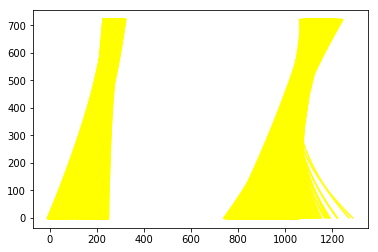

In [27]:
input_video = './project_video.mp4'
output_video = './project_video_lane_line_detection.mp4'

from moviepy.editor import VideoFileClip
from IPython.display import HTML



pipeline = PipeLine('./camera_cal/calibration*.jpg')

#input a video
clip1 = VideoFileClip(input_video)

# rewrite yhe video with lane line detected frames
white_clip = clip1.fl_image(pipeline)

%time white_clip.write_videofile(output_video, audio=False)